In [1]:
import pysimdeum
import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd
import xarray as xr
import copy
from datetime import datetime
from dataclasses import dataclass
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV
from skmultiflow.lazy import KNNClassifier, KNNADWINClassifier
from skmultiflow.meta import AdaptiveRandomForestClassifier
import skmultiflow.drift_detection as dd

from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier

import pickle

import sys
from pathlib import Path

module_path = str(Path.cwd() / "DAWIDD")
if module_path not in sys.path:
    sys.path.append(module_path)

import DAWIDD as SW
from experiments_utils import evaluate

%matplotlib inline

## Dataset Generation 

In [2]:
# Allgemeine Einstellungen
start_date = date_start = datetime.now().date()
rndm = np.random.RandomState(445602)

In [3]:
def features(dataset_X, dataset_y, summed = ['user']):
    solution_daily = 60*60*24
    solution_hours = 60*60
        
    summed_X = dataset_X.sum(summed).mean(['patterns'])
    
    reduced_X_hours = np.add.reduceat(summed_X.to_numpy(), np.arange(0, len(summed_X.to_numpy()), solution_hours))[:-1]
    reduced_X_daily = np.add.reduceat(summed_X.to_numpy(), np.arange(0, len(summed_X.to_numpy()), solution_daily))[:-1]
    
    if len(reduced_X_daily.shape) == 1:
        ones = np.ones((reduced_X_daily.shape[0], 4)) 
        ones[:,0] = reduced_X_daily
        
        ones[:,1] = [np.amin(reduced_X_hours[i*24:(i+1)*24]) for i in range(len(reduced_X_daily))]
        ones[:,2] = [np.amax(reduced_X_hours[i*24:(i+1)*24]) for i in range(len(reduced_X_daily))]
        ones[:,3] = [reduced_X_hours[i*24:(i+1)*24].mean() for i in range(len(reduced_X_daily))]

    
    elif len(reduced_X_daily.shape) == 2:
        
        ones = np.ones((reduced_X_daily.shape[0], reduced_X_daily.shape[1], 4)) 
        ones[:,:,0] = reduced_X_daily
    
        for e in range(len(dataset_X.coords['enduse'])):
            ones[:,e,1] = [np.amin(reduced_X_hours[i*24:(i+1)*24,e]) for i in range(len(reduced_X_daily))]
            ones[:,e,2] = [np.amax(reduced_X_hours[i*24:(i+1)*24,e]) for i in range(len(reduced_X_daily))]
            ones[:,e,3] = [reduced_X_hours[i*24:(i+1)*24,e].mean() for i in range(len(reduced_X_daily))]
        
    return shuffle(ones, dataset_y)    

### Genierung der Datensätze

In [691]:
# Drift: WcNormal -> WcNewSave und NormaleShower -> FancyShower
# Label: Anzahl Personen (1 - 3)

def generate_dataset_1(days = 60):
    
    duration = f'{days} day'
    x = pd.date_range(start= date_start, end= date_start + 2*pd.to_timedelta(duration) - pd.to_timedelta('1d'), freq='1d')
    
    # 1 Person - Normales WC
    person_1 = [{'gender': 'male', 'age': 'adult', 'job': True}]
    furnish_1 = ['WcNormal', 'KitchenTap', 'BathroomTap','NormalShower']
    random_state_user_day_1 = rndm.randint(days*5, size=(1, days))
    random_state_enduse_1 = rndm.randint(100, size=(days, len(furnish_1)))

    house_1 = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1) 
    consumptions_1 = house_1.simulate(duration = duration, random_state_enduse = random_state_enduse_1, random_state_user_day = random_state_user_day_1) 
    
    # 3 Personen - Normales WC
    person_2 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, {'gender': 'male', 'age': 'child', 'job': False}]
    furnish_2 = ['WcNormal', 'KitchenTap', 'BathroomTap','NormalShower']
    random_state_user_day_2 = rndm.randint(days*5, size=(3, days))
    random_state_enduse_2 = rndm.randint(len(furnish_2), size=(days, len(furnish_2)))

    house_2 = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2) 
    consumptions_2 = house_2.simulate(duration = duration, random_state_enduse = random_state_enduse_2, random_state_user_day = random_state_user_day_2) 
    
    # -------- Drift --------
    
    # 1 Person - NewSave WC
    furnish_1_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap', 'FancyShower']
    random_state_user_day_1_drift = rndm.randint(days*5, size=(1, days))
    random_state_enduse_1_drift = rndm.randint(100, size=(days, len(furnish_1_drift)))

    house_1_drift = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1_drift) 
    consumptions_1_drift = house_1_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_1_drift, random_state_user_day = random_state_user_day_1_drift) 
    
    # 3 Personen - NewSave WC
    furnish_2_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap', 'FancyShower']
    random_state_user_day_2_drift = rndm.randint(days*5, size=(3, days))
    random_state_enduse_2_drift = rndm.randint(len(furnish_2), size=(days, len(furnish_2_drift)))

    house_2_drift = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2_drift) 
    consumptions_2_drift = house_2_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_2_drift, random_state_user_day = random_state_user_day_2_drift) 
    
    # -------- Datensatz zusammenstellen -------- 
    
    data_y = [1]*days + [3]*days
    data_X, data_y = features(xr.concat([consumptions_1, consumptions_2], dim = 'time'), data_y, summed = ['user'])

    data_y_drift = [1]*days + [3]*days
    data_X_drift, data_y_drift = features(xr.concat([consumptions_1_drift, consumptions_2_drift], dim = 'time'), data_y_drift, summed = ['user'])

    data_X = np.concatenate((data_X, data_X_drift))
    data_y = np.concatenate((data_y, data_y_drift))
    
    return data_X, data_y
    

In [690]:
# Drift: WcNormal -> WcNewSave
# Label: Anzahl Personen (1 - 2)

def generate_dataset_2(days = 60):
    
    duration = f'{days} day'
    x = pd.date_range(start= date_start, end= date_start + 2*pd.to_timedelta(duration) - pd.to_timedelta('1d'), freq='1d')
    
    # 1 Person - Normales WC
    person_1 = [{'gender': 'male', 'age': 'adult', 'job': True}]
    furnish_1 = ['WcNormal', 'KitchenTap', 'BathroomTap','NormalShower']
    random_state_user_day_1 = rndm.randint(days*5, size=(1, days))
    random_state_enduse_1 = rndm.randint(100, size=(days, len(furnish_1)))

    house_1 = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1) 
    consumptions_1 = house_1.simulate(duration = duration, random_state_enduse = random_state_enduse_1, random_state_user_day = random_state_user_day_1) 
    
    # 2 Personen - Normales WC
    person_2 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': False}]
    furnish_2 = ['WcNormal', 'KitchenTap', 'BathroomTap','NormalShower']
    random_state_user_day_2 = rndm.randint(days*5, size=(3, days))
    random_state_enduse_2 = rndm.randint(len(furnish_2), size=(days, len(furnish_2)))

    house_2 = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2) 
    consumptions_2 = house_2.simulate(duration = duration, random_state_enduse = random_state_enduse_2, random_state_user_day = random_state_user_day_2) 
    
    # -------- Drift --------
    
    # 1 Person - NewSave WC
    furnish_1_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap', 'NormalShower']
    random_state_user_day_1_drift = rndm.randint(days*5, size=(1, days))
    random_state_enduse_1_drift = rndm.randint(100, size=(days, len(furnish_1_drift)))

    house_1_drift = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1_drift) 
    consumptions_1_drift = house_1_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_1_drift, random_state_user_day = random_state_user_day_1_drift)  
    
    # 2 Personen - NewSave WC
    furnish_2_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap', 'NormalShower']
    random_state_user_day_2_drift = rndm.randint(days*5, size=(3, days))
    random_state_enduse_2_drift = rndm.randint(len(furnish_2), size=(days, len(furnish_2_drift)))

    house_2_drift = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2_drift) 
    consumptions_2_drift = house_2_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_2_drift, random_state_user_day = random_state_user_day_2_drift) 
    
    # -------- Datensatz zusammenstellen -------- 
    
    data_y = [1]*days + [2]*days
    data_X, data_y = features(xr.concat([consumptions_1, consumptions_2], dim = 'time'), data_y, summed = ['user'])

    data_y_drift = [1]*days + [2]*days
    data_X_drift, data_y_drift = features(xr.concat([consumptions_1_drift, consumptions_2_drift], dim = 'time'), data_y_drift, summed = ['user'])

    data_X = np.concatenate((data_X, data_X_drift))
    data_y = np.concatenate((data_y, data_y_drift))
    
    return data_X, data_y

In [694]:
# Drift: 4 Endgeräte fallen weg
# Label: Anzahl Personen (5 -4)

def generate_dataset_3(days = 60):
    
    duration = f'{days} day'
    x = pd.date_range(start= date_start, end= date_start + 2*pd.to_timedelta(duration) - pd.to_timedelta('1d'), freq='1d')
    
    # 5 Person - vielen Endgeräten
    person_1 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': False}, 
                     {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, 
                     {'gender': 'female', 'age': 'senior', 'job': False}]
    
    furnish_1 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'FancyShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
    random_state_user_day_1 = rndm.randint(days*5, size=(len(person_1), days))
    random_state_enduse_1 = rndm.randint(100, size=(days, len(furnish_1)))

    house_1 = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1) 
    consumptions_1 = house_1.simulate(duration = duration, random_state_enduse = random_state_enduse_1, random_state_user_day = random_state_user_day_1) 
    
    # 4 Personen - weniger Endgeräten
    person_2 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': False}, 
                     {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}]
    
    furnish_2 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'FancyShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
    random_state_user_day_2 = rndm.randint(days*5, size=(len(person_2), days))
    random_state_enduse_2 = rndm.randint(len(furnish_2), size=(days, len(furnish_2)))
    
    house_2 = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2) 
    consumptions_2 = house_2.simulate(duration = duration, random_state_enduse = random_state_enduse_2, random_state_user_day = random_state_user_day_2)
    
    # -------- Drift --------
    
    # 1 Person - NewSave WC
    furnish_1_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap']
    random_state_user_day_1_drift = rndm.randint(days*5, size=(len(person_1), days))
    random_state_enduse_1_drift = rndm.randint(100, size=(days, len(furnish_1_drift)))

    house_1_drift = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1_drift) 
    consumptions_1_drift = house_1_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_1_drift, random_state_user_day = random_state_user_day_1_drift) 
    
    # Einfaches Datenset - 2 Personen - NewSave WC
    furnish_2_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap']
    random_state_user_day_2_drift = rndm.randint(days*5, size=(len(person_2), days))
    random_state_enduse_2_drift = rndm.randint(len(furnish_2), size=(days, len(furnish_2_drift)))

    house_2_drift = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2_drift) 
    consumptions_2_drift = house_2_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_2_drift, random_state_user_day = random_state_user_day_2_drift) 
    
    # -------- Datensatz zusammenstellen -------- 
    
    data_y = [1]*days + [2]*days
    data_X, data_y = features(xr.concat([consumptions_1, consumptions_2], dim = 'time'), data_y, summed = ['user'])
        
    data_y_drift = [1]*days + [2]*days
    data_X_drift, data_y_drift = features(xr.concat([consumptions_1_drift, consumptions_2_drift], dim = 'time'), data_y_drift, summed = ['user'])
    
    zeros = np.zeros(data_X.shape)
    zeros[:,0:data_X_drift.shape[1],:] = data_X_drift
    data_X_drift = zeros 
    
    data_X = np.concatenate((data_X, data_X_drift))
    data_y = np.concatenate((data_y, data_y_drift))
    
    return data_X, data_y

In [695]:
# Drift: Normal Shower -> Fancy Shower 
# Label: Anzahl Personen (7 - 6)

def generate_dataset_4(days = 60):
    
    duration = f'{days} day'
    x_axis = pd.date_range(start= date_start, end= date_start + 2*pd.to_timedelta(duration) - pd.to_timedelta('1d'), freq='1d')
    
    # 7 Person - NormalShower
    person_1 = [{'gender': 'male', 'age': 'adult', 'job': True},  {'gender': 'female', 'age': 'adult', 'job': False}, 
                     {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, 
                     {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, 
                     {'gender': 'female', 'age': 'senior', 'job': False}]
    
    furnish_1 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
    random_state_user_day_1 = rndm.randint(days*5, size=(len(person_1), days))
    random_state_enduse_1 = rndm.randint(100, size=(days, len(furnish_1)))

    house_1 = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1) 
    consumptions_1 = house_1.simulate(duration = duration, random_state_enduse = random_state_enduse_1, random_state_user_day = random_state_user_day_1) 
    
    # 6 Personen - NormalShower
    person_2 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': False}, 
                     {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, 
                     {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}]
    
    furnish_2 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
    random_state_user_day_2 = rndm.randint(days*5, size=(len(person_2), days))
    random_state_enduse_2 = rndm.randint(len(furnish_2), size=(days, len(furnish_2)))
    
    house_2 = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2) 
    consumptions_2 = house_2.simulate(duration = duration, random_state_enduse = random_state_enduse_2, random_state_user_day = random_state_user_day_2)
    
    # -------- Drift --------
    
    # 7 Person - FancyShower
    furnish_1_drift = ['WcNormal', 'KitchenTap', 'BathroomTap', 'FancyShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
    random_state_user_day_1_drift = rndm.randint(days*5, size=(len(person_1), days))
    random_state_enduse_1_drift = rndm.randint(100, size=(days, len(furnish_1_drift)))

    house_1_drift = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1_drift) 
    consumptions_1_drift = house_1_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_1_drift, random_state_user_day = random_state_user_day_1_drift) 
    
    # 6  Personen - FancyShower
    furnish_2_drift = ['WcNormal', 'KitchenTap', 'BathroomTap', 'FancyShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
    random_state_user_day_2_drift = rndm.randint(days*5, size=(len(person_2), days))
    random_state_enduse_2_drift = rndm.randint(len(furnish_2), size=(days, len(furnish_2_drift)))

    house_2_drift = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2_drift) 
    consumptions_2_drift = house_2_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_2_drift, random_state_user_day = random_state_user_day_2_drift) 
    
    # -------- Datensatz zusammenstellen -------- 
    
    data_y = [1]*days + [2]*days
    data_X, data_y = features(xr.concat([consumptions_1, consumptions_2], dim = 'time'), data_y, summed = ['user'])
        
    data_y_drift = [1]*days + [2]*days
    data_X_drift, data_y_drift = features(xr.concat([consumptions_1_drift, consumptions_2_drift], dim = 'time'), data_y_drift, summed = ['user'])
    
    data_X = np.concatenate((data_X, data_X_drift))
    data_y = np.concatenate((data_y, data_y_drift))
    
    return data_X, data_y

In [696]:
# Drift: WcNormal -> WcNewSave
# Label: Anzahl Personen (4 - 5)

def generate_dataset_5(days = 60):
    
    duration = f'{days} day'
    x = pd.date_range(start= date_start, end= date_start + 2*pd.to_timedelta(duration) - pd.to_timedelta('1d'), freq='1d')

    # 4 Personen - Normales WC
    person_1 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, 
                       {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}]
    furnish_1 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine']
    random_state_user_day_1 = rndm.randint(days*5, size=(4, days))
    random_state_enduse_1 = rndm.randint(100, size=(days, len(furnish_1)))

    house_1 = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1) 
    consumptions_1 = house_1.simulate(duration = duration, random_state_enduse = random_state_enduse_1, random_state_user_day = random_state_user_day_1) 
    
    # 5 Personen - Normales WC
    person_2 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, 
                       {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, {'gender': 'female', 'age': 'senior', 'job': False}]
    furnish_2 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine']
    random_state_user_day_2 = rndm.randint(days*5, size=(5, days))
    random_state_enduse_2 = rndm.randint(100, size=(days, len(furnish_2)))

    house_2 = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2) 
    consumptions_2 = house_2.simulate(duration = duration, random_state_enduse = random_state_enduse_2, random_state_user_day = random_state_user_day_2) 
    
    # -------- Drift --------

    # 4 Personen - New Save WC
    furnish_1_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine']
    random_state_user_day_1_drift = rndm.randint(days*5, size=(4, days))
    random_state_enduse_1_drift = rndm.randint(100, size=(days, len(furnish_1)))

    house_1_drift = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1_drift) 
    consumptions_1_drift = house_1_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_1_drift, random_state_user_day = random_state_user_day_1_drift)

    # 5 Personen - New Save WC
    furnish_2_drift = ['WcNewSave', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine']
    random_state_user_day_2_drift = rndm.randint(days*5, size=(5, days))
    random_state_enduse_2_drift = rndm.randint(100, size=(days, len(furnish_2_drift)))

    house_2_drift = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2_drift) 
    consumptions_2_drift = house_2_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_2_drift, random_state_user_day = random_state_user_day_2_drift) 
    
    # -------- Datensatz zusammenstellen -------- 
    
    data_y = [1]*days + [3]*days
    data_X, data_y = features(xr.concat([consumptions_1, consumptions_2], dim = 'time'), data_y, summed = ['user'])

    data_y_drift = [1]*days + [3]*days
    data_X_drift, data_y_drift = features(xr.concat([consumptions_1_drift, consumptions_2_drift], dim = 'time'), data_y_drift, summed = ['user'])

    data_X = np.concatenate((data_X, data_X_drift))
    data_y = np.concatenate((data_y, data_y_drift))
    
    return data_X, data_y

In [697]:
# Drift: Anzahl Personen (4 -> 5)
# Label: Duschtyp (NormalShower - FancyShower
def generate_dataset_6(days = 60): 
    duration = f'{days} day'
    x = pd.date_range(start= date_start, end= date_start + 2*pd.to_timedelta(duration) - pd.to_timedelta('1d'), freq='1d')

    # Normale Dusche - 4 Personen
    person_1 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, 
                       {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}]
    furnish_1 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine']
    random_state_user_day_1 = rndm.randint(days*5, size=(4, days))
    random_state_enduse_1 = rndm.randint(100, size=(days, len(furnish_1)))

    house_1 = pysimdeum.built_house(house_type = 'own_person', users = person_1, furnish = furnish_1) 
    consumptions_1 = house_1.simulate(duration = duration, random_state_enduse = random_state_enduse_1, random_state_user_day = random_state_user_day_1) 
    
    # Fancy Dusche - 4 Personen
    person_2 = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, 
                       {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}]
    furnish_2 = ['WcNormal', 'KitchenTap', 'BathroomTap', 'FancyShower', 'WashingMachine']
    random_state_user_day_2 = rndm.randint(days*5, size=(4, days))
    random_state_enduse_2 = rndm.randint(100, size=(days, len(furnish_2)))

    house_2 = pysimdeum.built_house(house_type = 'own_person', users = person_2, furnish = furnish_2) 
    consumptions_2 = house_2.simulate(duration = duration, random_state_enduse = random_state_enduse_2, random_state_user_day = random_state_user_day_2) 
    
    # -------- Drift --------

    # Normale Dusche - 5 Personen
    person_1_drift = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, 
                       {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, {'gender': 'female', 'age': 'senior', 'job': False}]
    random_state_user_day_1_drift = rndm.randint(days*5, size=(5, days))
    random_state_enduse_1_drift = rndm.randint(100, size=(days, len(furnish_1)))

    house_1_drift = pysimdeum.built_house(house_type = 'own_person', users = person_1_drift, furnish = furnish_1) 
    consumptions_1_drift = house_1_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_1_drift, random_state_user_day = random_state_user_day_1_drift) 
    
    # Fancy Dusche - 5 Personen
    person_2_drift = [{'gender': 'male', 'age': 'adult', 'job': True}, {'gender': 'female', 'age': 'adult', 'job': True}, 
                       {'gender': 'male', 'age': 'child', 'job': False}, {'gender': 'female', 'age': 'teen', 'job': False}, {'gender': 'female', 'age': 'senior', 'job': False}]
    random_state_user_day_2_drift = rndm.randint(days*5, size=(5, days))
    random_state_enduse_2_drift = rndm.randint(100, size=(days, len(furnish_1)))

    house_2_drift = pysimdeum.built_house(house_type = 'own_person', users = person_2_drift, furnish = furnish_2) 
    consumptions_2_drift = house_2_drift.simulate(duration = duration, random_state_enduse = random_state_enduse_2_drift, random_state_user_day = random_state_user_day_2_drift) 
    
    # -------- Datensatz zusammenstellen -------- 

    data_y = [1]*days + [3]*days
    data_X, data_y = features(xr.concat([consumptions_1, consumptions_2], dim = 'time'), data_y, summed = ['user'])

    data_y_drift = [1]*days + [3]*days
    data_X_drift, data_medium_y_drift = features(xr.concat([consumptions_1_drift, consumptions_2_drift], dim = 'time'), data_y_drift, summed = ['user'])

    data_X = np.concatenate((data_X, data_X_drift))
    data_y = np.concatenate((data_y, data_y_drift))
    
    return data_X, data_y

## Online Learning

In [706]:
# Plot der Summe der Wasserverbrauchsdaten

def print_X(data_X, data_y, title):

    x_axis = pd.date_range(start= date_start, end= date_start + pd.to_timedelta(f"{int(len(data_X))} days") - pd.to_timedelta('1d'), freq='1d')
    
    plt.figure(figsize=(11,3))
    if len(data_X.shape) > 2: 
        data_X = data_X.sum(axis=1)
    plt.plot(x_axis, data_X[:,0]) 
    plt.ylabel("Wasserverbrauch [L]")
    plt.xlabel("Zeit")
    plt.axvline(x = x_axis[int(len(data_X)/2)], color = 'y')
    window = 10
    plt.plot(x_axis[int(window/2): int(len(data_X) - (window/2) +1)], np.convolve(data_X[:,0], np.ones(window)/window, mode='valid'))
    #plt.savefig(title + "_data" + ".png")

In [707]:
# Online-Learning Modelle trainieren und Accuracy ausgeben

def run_classification(data_X, data_y, level, print_plots = True):
    
    classifiers = [ {"name": 'KNN', "model": KNNClassifier(n_neighbors=1, max_window_size=40), "acc_score": []},                          
                    {"name": 'ARF', 'model': AdaptiveRandomForestClassifier(n_estimators = 20, drift_detection_method = None), "acc_score": []}]

    for modell in classifiers: 
        
        corrects = 0
        n_samples = 0
        acc_score = []
        my_preds = []

        classifier = modell["model"]
        classifier.reset()

        for i in range(0, len(data_X)):        
            X = np.array(data_X[i]).reshape(1, -1)
            y = [data_y[i]]
            my_pred = classifier.predict(X)
            my_preds.append(my_pred)
            if y == my_pred:
                corrects += 1
            classifier = classifier.partial_fit(X, y)
            n_samples += 1
            acc_score.append(corrects/n_samples) 
        modell['acc_score'] = acc_score
    
    fig, axs = plt.subplots(1, 2, figsize=(10,4))
    for i, class_ in enumerate(classifiers): 
        axs[i].set_title(f"{class_['name']}")
        axs[i].set_ylabel("Accuracy")
        axs[i].set_xlabel("Zeit")
        axs[i].axvline(x = len(data_X)/2, color = 'y')
        axs[i].set_ylim([0,1])
        axs[i].plot(class_['acc_score']) 
        
    return classifiers 

In [708]:
# Drift Detetkionsmethoden ausführen und die Ergebnisse evaluiern

def run_drift_detection(classifier, drift): 
       
    detection_methods = [{'name': 'DDM', 'model': dd.DDM(min_num_instances=60, warning_level = 1, out_control_level = 1.0), 'detected': []},
                         {'name': 'PH', 'model': dd.PageHinkley(min_instances = 25, delta = 0.001, threshold = 0.70 , alpha = 0.999), 'detected': []},
                         {'name': 'ADWIN', 'model': dd.ADWIN(delta = 5), 'detected': []}, 
                         {'name': 'KSWIN', 'model': dd.KSWIN(alpha = 0.000000000001, window_size = 60, stat_size = 30), 'detected': [] },
                         {'name': 'DAWIDD', 'model': SW.DAWIDD(max_window_size = 300, min_window_size = 100, min_p_value = 0.1), 'detected': []}]

    evalutation = []
    
    for modell in classifier: 
        acc_score = modell['acc_score']
        length = int(len(acc_score)/4)
            
        for j, detec in enumerate(detection_methods): 
            
            ddm = detec['model']
            if detec['name'] == 'DAWIDD': 
                ddm = SW.DAWIDD(max_window_size = 50, min_window_size = 35, min_p_value = 0.001)
            else:
                ddm.reset()
            change_detected = []
            
            # Für DDM werden binaere Daten benötigt
            if 'DDM' in detec['name']:
                if modell['name'] != 'Daten': 
                    for i in range(100,len(acc_score)):
                        ddm.add_element(int(acc_score[i-1] < acc_score[i]))

                        if ddm.detected_change():
                                change_detected.append(i) 
                     
            # Page-Hinkley beidseitig ausführen, um mehr Drifts zu erkennen
            elif detec['name'] == 'PH':
                if modell['name'] != 'Daten': 
                
                    for i in range(100,len(acc_score)):
                        ddm.add_element(acc_score[i])

                        if ddm.detected_change():
                                change_detected.append(i) 

                    ddm.reset()

                    for i in range(100,len(acc_score)):
                        ddm.add_element(1 - acc_score[i])

                        if ddm.detected_change():
                                change_detected.append(i) 
                                
            # DAWIDD benötigt noch zusätzlich das y-Label und hat andere Methodennamen
            elif detec['name'] == 'DAWIDD': 
                
                for i in range(100,len(acc_score)):
                    ddm.add_batch(np.concatenate((np.array([acc_score[i]]), np.array([int(acc_score[i-1] < acc_score[i])])), axis=0))

                    if ddm.detected_change():
                        change_detected.append(i)
                        
            else:
                for i in range(100,len(acc_score)):
                    ddm.add_element(acc_score[i])

                    if ddm.detected_change():
                            change_detected.append(i) 
    
                
            if modell['name'] == 'Daten' and detec['name'] in ['DDM', 'PH']:
                ...
            else: 
                evalutation.append({'classifier_name': modell['name'], 'detection_name': detec['name'], 'acc_score': acc_score, 'detected': change_detected, 'evalutation': evaluate(drift, change_detected, tol=100)})  
        
    return evalutation

In [709]:
# DAWIDD auf den Wasserdaten ausführen und evaluieren 

def run_DAWIDD(data_X, data_Y, drift, print_plots = True, title = ""):
    
    dawidd = SW.DAWIDD(max_window_size = 50, min_window_size = 35, min_p_value = 0.001)
    
    change_detected = []

    for i, elem in enumerate(data_X): 
        dawidd.add_batch(np.concatenate((elem.flatten(), np.array([data_Y[i]])), axis=0))

        if dawidd.detected_change():
            change_detected.append(i)    

    if print_plots: 
        x_axis = pd.date_range(start= date_start, end= date_start + pd.to_timedelta(f"{len(data_X)} days") - pd.to_timedelta('1d'), freq='1d') 
        plt.figure(figsize=(11,2))

        if len(data_X.shape) > 2: 
            plt_data = data_X.sum(axis=1)[:,0]
        else: 
            plt_data = data_X[:,0]
        plt.plot(x_axis, plt_data)
        plt.title("DAWIDD")
        for i, change in enumerate(change_detected):
            if i == 0:
                plt.axvline(x = x_axis[change], color = 'r', label = 'Drift erkannt')
        plt.axvline(x = x_axis[int(len(data_X)/2)], color = 'y', label = 'Driftzeitpunkt')
        plt.ylabel("Wasserverbrauch [L]")
        plt.xlabel("Zeit")

    #plt.savefig(title + "_dawidd" + ".png")
       
    return {'classifier_name': 'DAWIDD', 'detection_name': 'DAWIDD', 'evalutation': evaluate(drift, change_detected, tol=100), 'detected': change_detected, 'acc_score': plt_data}

In [710]:
# Die Evaluation über alle Classifier und Drift Detektionsmethoden ausgeben 

def print_evaluation(evaluation): 
    evas_sorted = sorted(evaluation, key=lambda x: (x[0], x[1]))

    classifier = ''
    detection = ''

    liste = []

    false_alarms = []
    drift_detected = []
    drift_not_detected = []
    delay = []


    for tup in evas_sorted:     
        if classifier == '' and detection == '':
            classifier = tup[0]
            detection = tup[1]

        if classifier != tup[0] or detection != tup[1]:
            liste.append((classifier, detection, [false_alarms, drift_detected, drift_not_detected, delay]))
            false_alarms = []
            drift_detected = []
            drift_not_detected = []
            delay = []
            classifier = tup[0]
            detection = tup[1]
            false_alarms.append(tup[2][0])
            drift_detected.append(tup[2][1])
            drift_not_detected.append(tup[2][2])
            delay += tup[2][3]

        else: 
            false_alarms.append(tup[2][0])
            drift_detected.append(tup[2][1])
            drift_not_detected.append(tup[2][2])
            delay += tup[2][3]
    liste.append((classifier, detection, [false_alarms, drift_detected, drift_not_detected, delay]))
            
    print("Classifier \t Detection \t False Alarm \t Drift detected \t Drift not \t Delay")
    for entry in liste: 
        print(f"{entry[0]} \t \t {entry[1]}\t: \t {np.array(entry[2][0]).mean()} \t \t {np.array(entry[2][1]).mean()} \t \t \t {np.array(entry[2][2]).mean()} \t \t {np.array(entry[2][3])}")
        
    return liste

In [711]:
# Beste Accuracy über alle fünf Durchläufe ausgeben 

def print_accuracy(classifier, title): 
    
    acc_knn = []
    acc_arf = []
    
    best_acc_knn = [0]
    best_acc_arf = [0]
    
    for clas in classifier: 
        if clas['name'] == 'KNN': 
            acc_knn.append(np.array(clas['acc_score'][-1]))
            if best_acc_knn[-1] < clas['acc_score'][-1]:
                best_acc_knn = clas['acc_score']
        elif clas['name'] == 'ARF': 
            acc_arf.append(np.array(clas['acc_score'][-1]))
            if best_acc_arf[-1] < clas['acc_score'][-1]:
                best_acc_arf = clas['acc_score']
            
    print(f"KNN Accuracy - {round(np.array(acc_knn).mean(), 2)}")
    print(f"ARF Accuracy - {round(np.array(acc_arf).mean(), 2)}")
    print(f"{round(np.array(acc_knn).mean(),2)} & {round(np.array(acc_arf).mean(),2)}")
    fig, axs = plt.subplots(1, 2, figsize=(10,4))
    axs[0].plot(best_acc_knn)
    axs[0].set_ylim([0,1])
    axs[0].set_title("KNN")
    axs[0].set_ylabel("Accuracy")
    axs[0].set_xlabel("Zeit")
    
    axs[1].plot(best_acc_arf)
    axs[1].set_ylim([0,1])
    axs[1].set_title("ARF")
    axs[1].set_ylabel("Accuracy")
    axs[1].set_xlabel("Zeit")
    
    #plt.savefig(title + "_accs" + ".png")
    

In [712]:
# Ausfuehren der Experimente, neue Datenpunkte hinzufügen

def compute_online(datasets, title_tmp, days, print_plots, sum_ = False): 

    evaluations = []
    classifiers = []
    detections = []

    for i, (X_tmp,y_tmp) in enumerate(datasets): 
        
        title = title_tmp + "_" + str(i) 
        
        X = copy.deepcopy(X_tmp)
        y = copy.deepcopy(y_tmp)
        
        add_elements = 300
        
        rnd = np.random.randint(0,200, add_elements)
        X = np.concatenate((X[rnd,:,:], X))
        y = np.concatenate((y[rnd], y))
        
        rnd = np.random.randint(500,700, add_elements)
        X = np.concatenate((X, X[rnd,:,:]))
        y = np.concatenate((y, y[rnd]))
        
        if sum_ and len(X.shape) == 3:
            X = X.sum(axis=1)
        
        if print_plots:
            print_X(X, y, title)
                    
        classifier = run_classification(X, y, title, print_plots = print_plots)
        classifiers += classifier 
        
        if len(X.shape) > 2: 
            X_base = X.sum(axis=1)
        else: 
            X_base = X
        #classifier.append({"name": 'Daten', 'model': None, "acc_score": X_base[:,0]})
    
        evaluation = run_drift_detection(classifier, [int(len(X)/2)])
        
        evaluation.append(run_DAWIDD(X, y, [int(len(X)/2)], print_plots = print_plots, title = title))
    
        for eva in evaluation:         
            evaluations.append((list(eva.values())[0], list(eva.values())[1], list(eva['evalutation'].values())))
        
        print_detections(evaluation, title) 
        
    latex_table = print_evaluation(evaluations)
    print_accuracy(classifiers, title)
    print_latex_table(latex_table)

In [713]:
# Datensatz speichern

def save(data, filename): 
    with open(filename + '.pkl', 'wb') as f:
        pickle.dump(data, f)

In [714]:
# Datensatz laden

def load(filename): 
    with open(filename + '.pkl', 'rb') as f:
        return pickle.load(f)

In [715]:
# Ausgabe der Latextabelle 

def print_latex_table(evaluations):
    
    evas_sorted = sorted(evaluations, key=lambda x: (x[0], x[1]))
    
    act_class = ''
    
    class_ = []
    drift = []
    
    false_alarms = []
    drift_detected = []
    drift_not_detected = []
    delay = []
    
    dawidd = []
    
    for tup in evas_sorted:     
        
        if tup[0] == 'DAWIDD':
            dawidd = tup
        else:
            class_.append(tup[0])
            drift.append(tup[1])
            false_alarms.append(np.array(tup[2][0]).mean())
            drift_detected.append(np.array(tup[2][1]).mean())
            drift_not_detected.append(np.array(tup[2][2]).mean())
            delay += [tup[2][3]]
     
    class_.append(dawidd[0])
    drift.append(dawidd[1])
    false_alarms.append(np.array(dawidd[2][0]).mean())
    drift_detected.append(np.array(dawidd[2][1]).mean())
    drift_not_detected.append(np.array(dawidd[2][2]).mean())
    delay += [dawidd[2][3]]
    
    
    print(*class_, sep=" & ") 
    print(*drift, sep= " & ")
    print("& FA$^1$", *false_alarms, sep=" & ")       
    print("& Erkannt", *drift_detected, sep=" & ")       
    print("& Nicht", *drift_not_detected, sep=" & ") 
    print("& Delay", *delay, sep=" & ")   

In [702]:
# Plots der Drift Detektionen über Accuracy ausgeben

def print_detections(detections, title):
                     
    fig, axs = plt.subplots(5, 2, figsize=(10,10))
    fig.tight_layout(pad=4.0)
    
    j_knn = 0
    j_arf = 0
    
    j = 0
    for modell in detections[:-1]:
        
        
        if modell['classifier_name'] == 'KNN':
            i = 0
            j = j_knn
            j_knn += 1
        elif modell['classifier_name'] == 'ARF':
            i = 1
            j = j_arf
            j_arf += 1
            
        change_detected = modell['detected']
        acc_score = modell['acc_score']
        
        
        axs[j, i].set_ylim([0.4,1.1])    
        axs[j, i].plot(acc_score, zorder = 1)
        axs[j, i].axvline(x = len(acc_score)/2, color = 'y', zorder=0, label="Driftzeitpunkt")
        axs[j, i].set_title(f"{modell['classifier_name']} - {modell['detection_name']}")
        axs[j, i].set_ylabel("Accuracy")
        axs[j, i].set_xlabel("Zeit")
        for change in change_detected:
            axs[j, i].axvline(x = change, color = 'r', zorder = 2)
        
    plt.savefig(title + "_ddms" + ".png")
           

## Generierung Datensätze

In [20]:
days_1 = 100
days_2 = 100
days_3 = 100
days_4 = 100
days_5 = 100
days_6 = 100

In [394]:
dataset_1_enduse = []
for i in range(5):
    dataset_1_enduse.append((generate_dataset_1(days_1)))
save(dataset_1_enduse, f'{dataset_1_enduse=}'.split('=')[0])

In [395]:
dataset_2_enduse = []
for i in range(5):
    dataset_2_enduse.append((generate_dataset_2(days_2)))
save(dataset_2_enduse, f'{dataset_2_enduse=}'.split('=')[0])

In [396]:
dataset_3_enduse = []
for i in range(5):
    dataset_3_enduse.append((generate_dataset_3(days_3)))
save(dataset_3_enduse, f'{dataset_3_enduse=}'.split('=')[0])

In [397]:
dataset_4_enduse = []
for i in range(5):
    dataset_4_enduse.append((generate_dataset_4(days_4)))
save(dataset_4_enduse, f'{dataset_4_enduse=}'.split('=')[0])

In [398]:
dataset_5_enduse = []
for i in range(5):
    dataset_5_enduse.append((generate_dataset_5(days_5)))
save(dataset_5_enduse, f'{dataset_5_enduse=}'.split('=')[0])

In [399]:
dataset_6_enduse = []
for i in range(5):
    dataset_6_enduse.append((generate_dataset_6(days_6)))
save(dataset_6_enduse, f'{dataset_6_enduse=}'.split('=')[0])

In [22]:
# Datensätze laden
dataset_1_enduse = load("dataset_1_enduse")
dataset_2_enduse = load("dataset_2_enduse")
dataset_3_enduse = load("dataset_3_enduse")
dataset_4_enduse = load("dataset_4_enduse")
dataset_5_enduse = load("dataset_5_enduse")
dataset_6_enduse = load("dataset_6_enduse")

## Evaluation der Datensätze

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 7.0 	 	 0.6 	 	 	 0.4 	 	 [15 15 15]
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 7.0 	 	 1.0 	 	 	 0.0 	 	 [ 3 18 12  3  9]
ARF 	 	 KSWIN	: 	 19.4 	 	 1.0 	 	 	 0.0 	 	 [33 27 38 29 36]
ARF 	 	 PH	: 	 3.2 	 	 0.0 	 	 	 1.0 	 	 []
DAWIDD 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 3.4 	 	 0.2 	 	 	 0.8 	 	 [79]
KNN 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 11.6 	 	 1.0 	 	 	 0.0 	 	 [26 21 18 29  2]
KNN 	 	 KSWIN	: 	 14.2 	 	 1.0 	 	 	 0.0 	 	 [90 46 80 55 35]
KNN 	 	 PH	: 	 1.4 	 	 0.0 	 	 	 1.0 	 	 []
KNN Accuracy - 0.97
ARF Accuracy - 0.97
0.97 & 0.97
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 7.0 & 0.0 & 7.0 & 19.4 & 3.2 & 3.4 & 0.0 & 11.6 & 14.2 & 1.4 & 0.0
& Erkannt & 0.6 & 0.0 & 1.0 & 1.0 & 0.0 & 0.2 & 0.0 & 1.0 & 1.0 & 0.

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


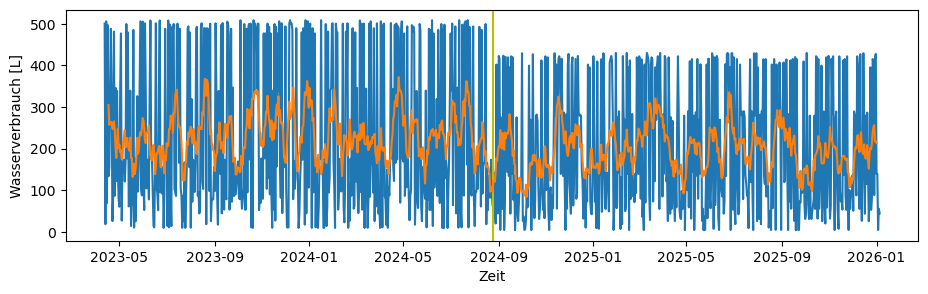

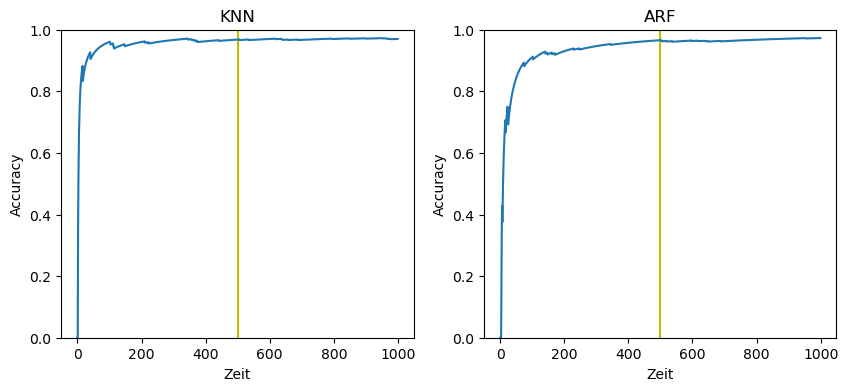

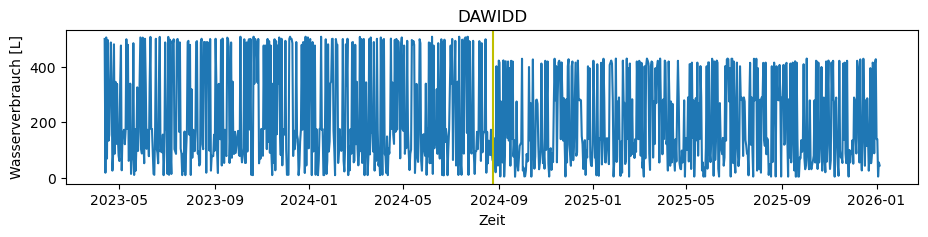

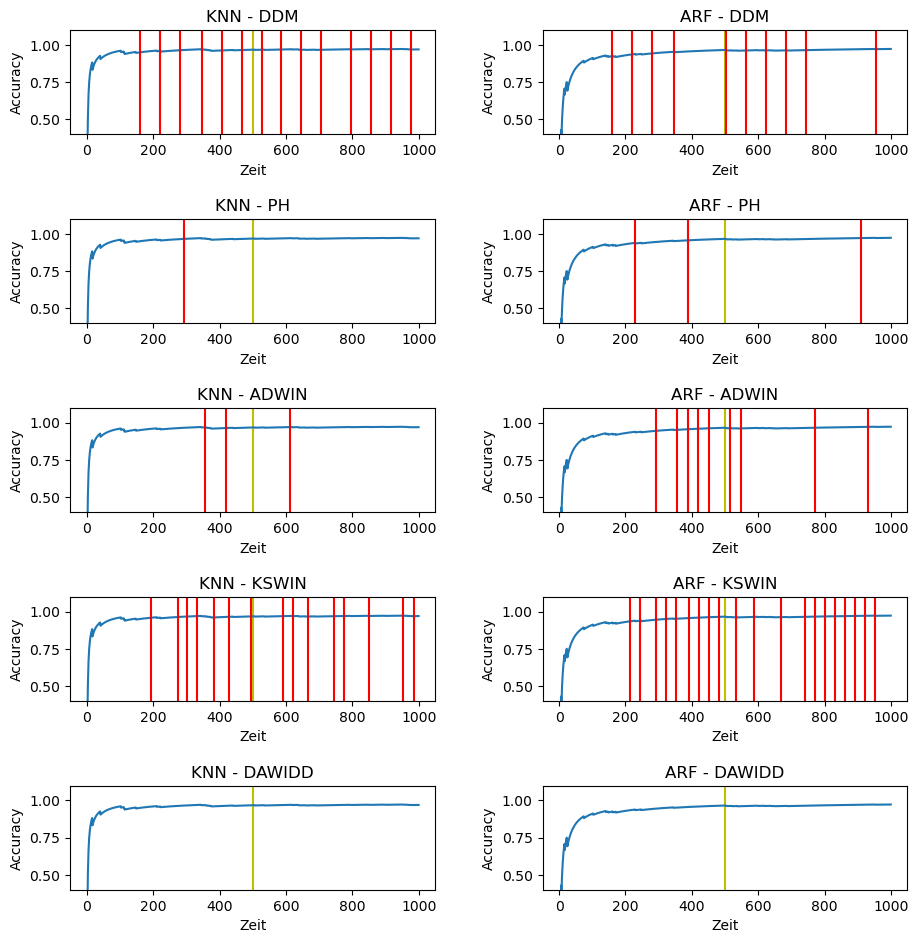

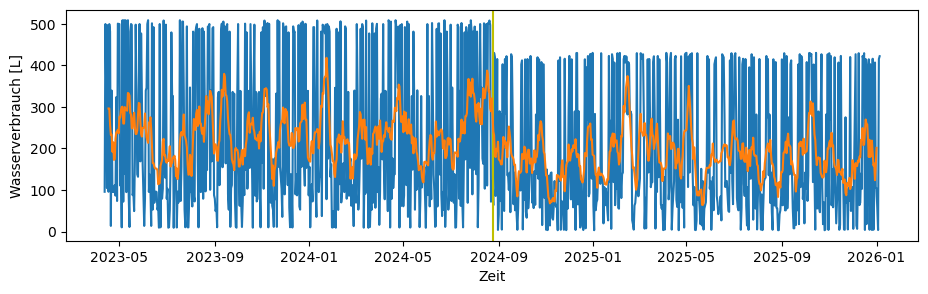

...

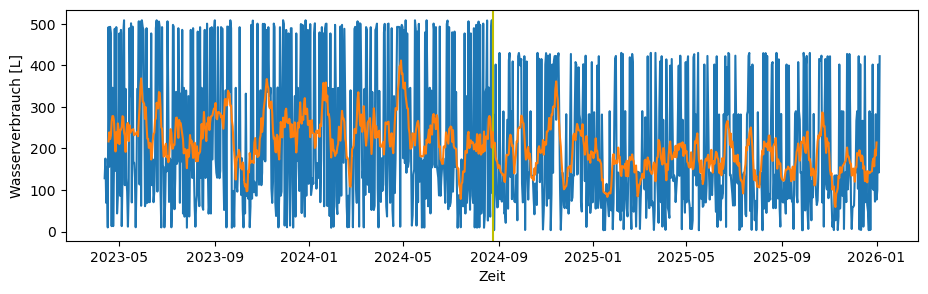

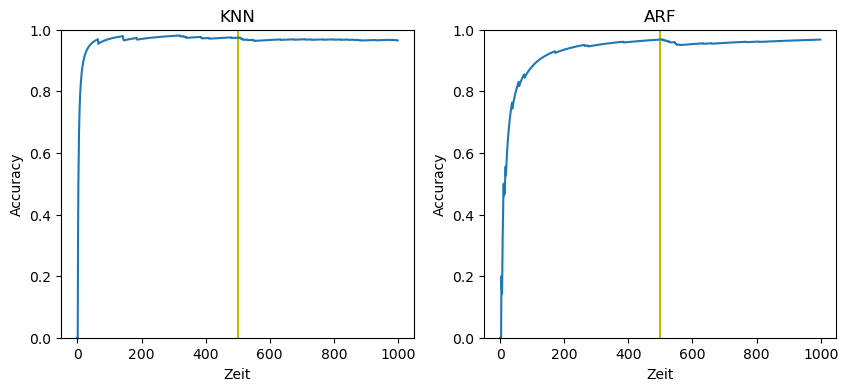

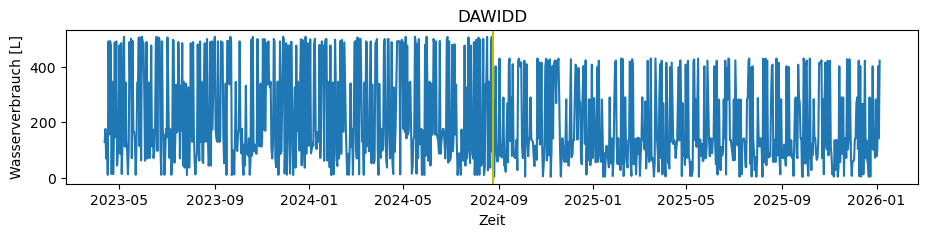

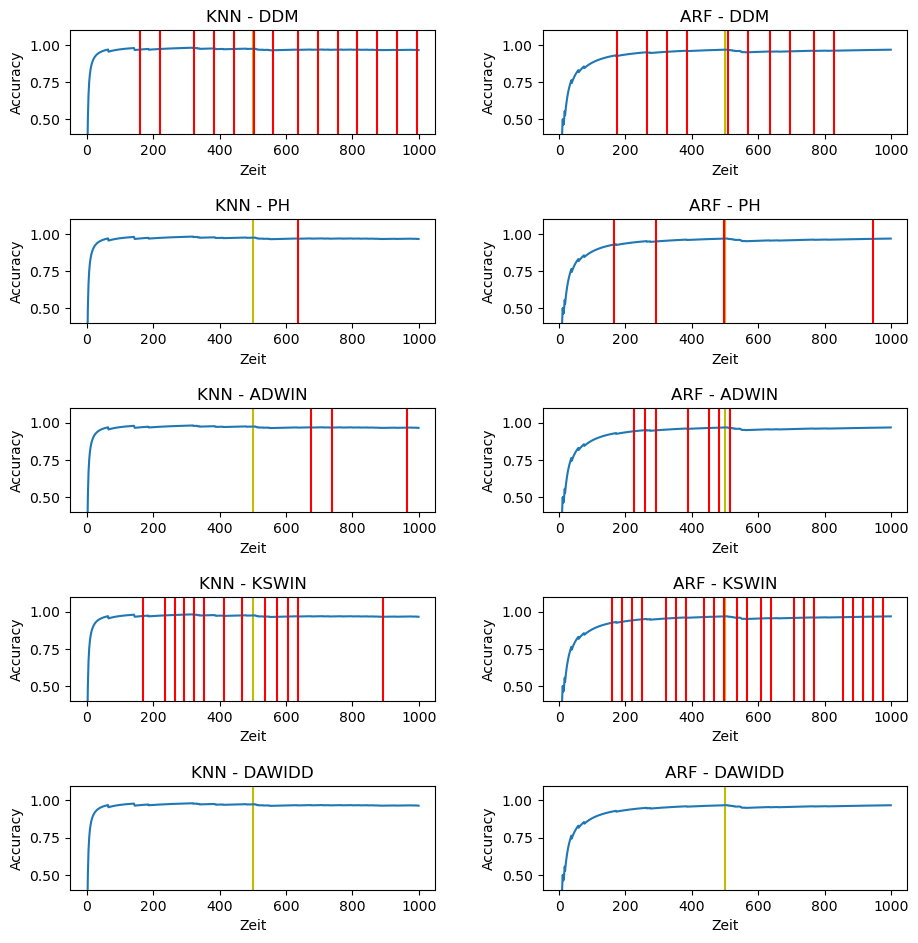

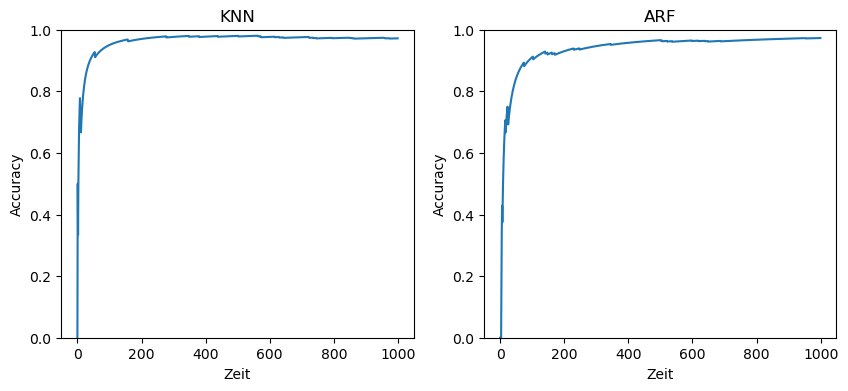

In [643]:
compute_online(dataset_1_enduse, 'Datensatz 1', days_1, True, True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 3.6 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 0.2 	 	 1.0 	 	 	 0.0 	 	 [3 1 1 1 2]
ARF 	 	 KSWIN	: 	 25.2 	 	 1.0 	 	 	 0.0 	 	 [29 27 27 27 28]
ARF 	 	 PH	: 	 1.4 	 	 0.0 	 	 	 1.0 	 	 []
DAWIDD 	 	 DAWIDD	: 	 0.2 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 3.0 	 	 0.2 	 	 	 0.8 	 	 [79]
KNN 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 11.0 	 	 1.0 	 	 	 0.0 	 	 [38 21 18 57 39]
KNN 	 	 KSWIN	: 	 14.6 	 	 1.0 	 	 	 0.0 	 	 [61 47 78 57  6]
KNN 	 	 PH	: 	 1.2 	 	 0.0 	 	 	 1.0 	 	 []
KNN Accuracy - 0.97
ARF Accuracy - 0.99
0.97 & 0.99
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 3.6 & 0.0 & 0.2 & 25.2 & 1.4 & 3.0 & 0.0 & 11.0 & 14.6 & 1.2 & 0.2
& Erkannt & 0.0 & 0.0 & 1.0 & 1.0 & 0.0 & 0.2 & 0.0 & 1.0 & 1.0 & 0.0 & 0.0
& Nic

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


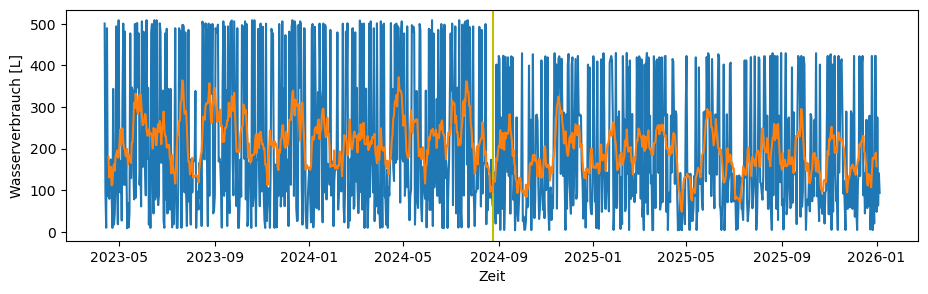

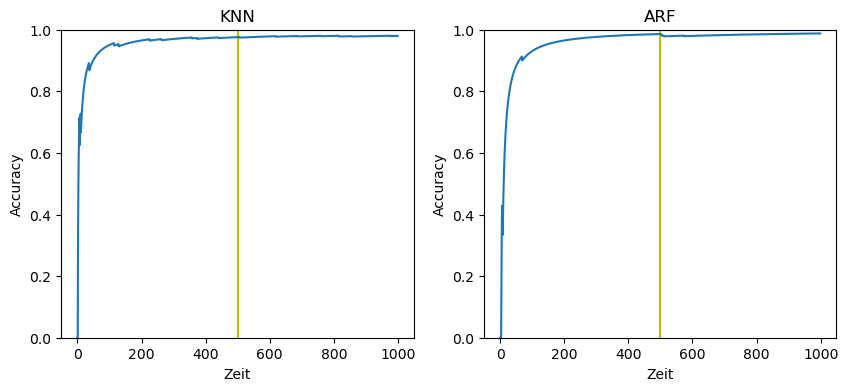

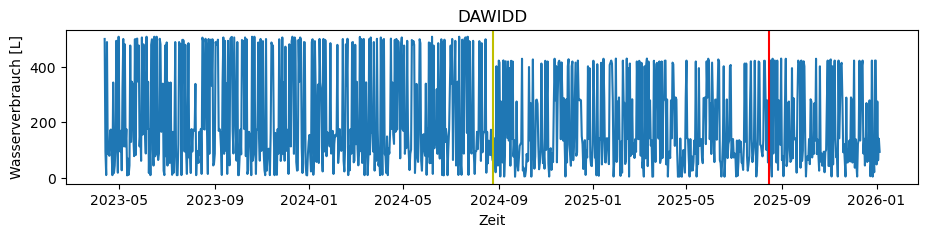

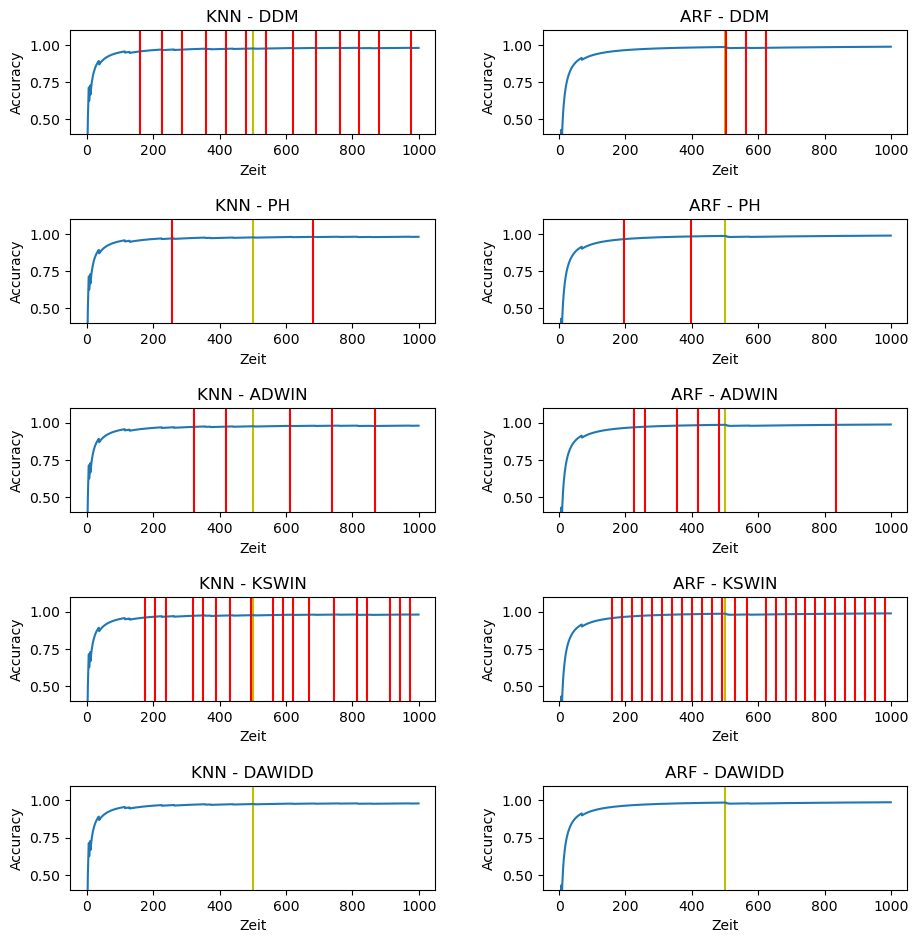

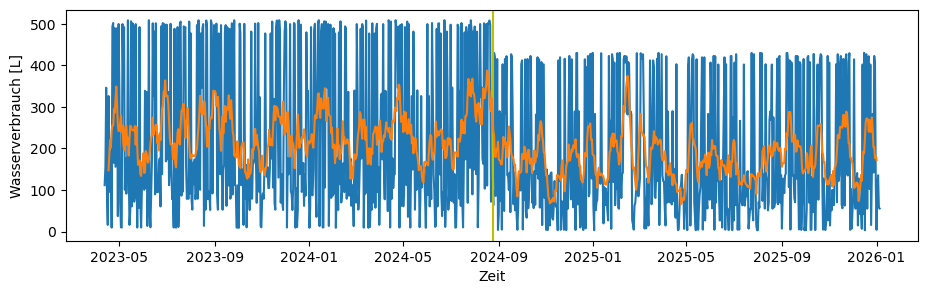

...

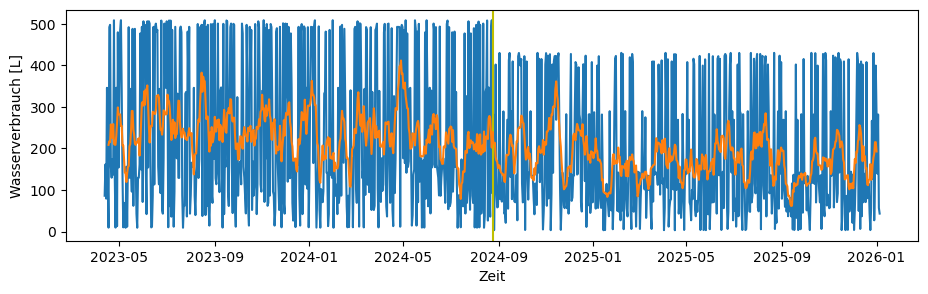

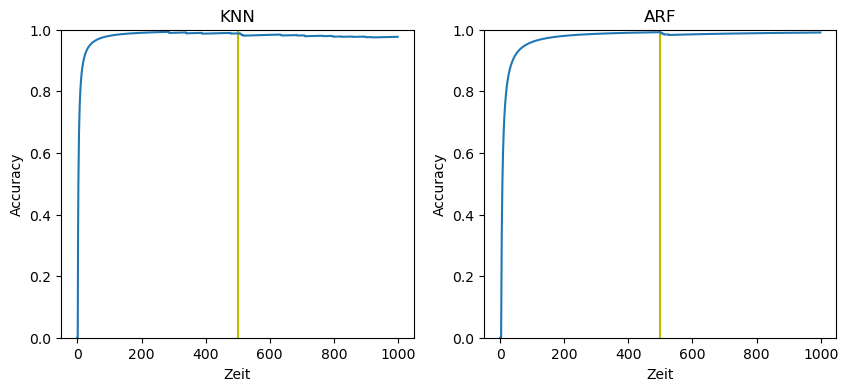

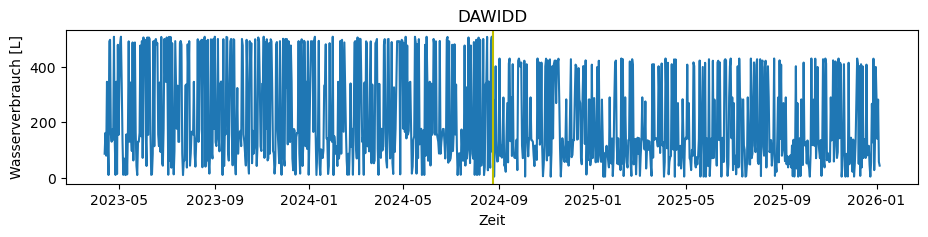

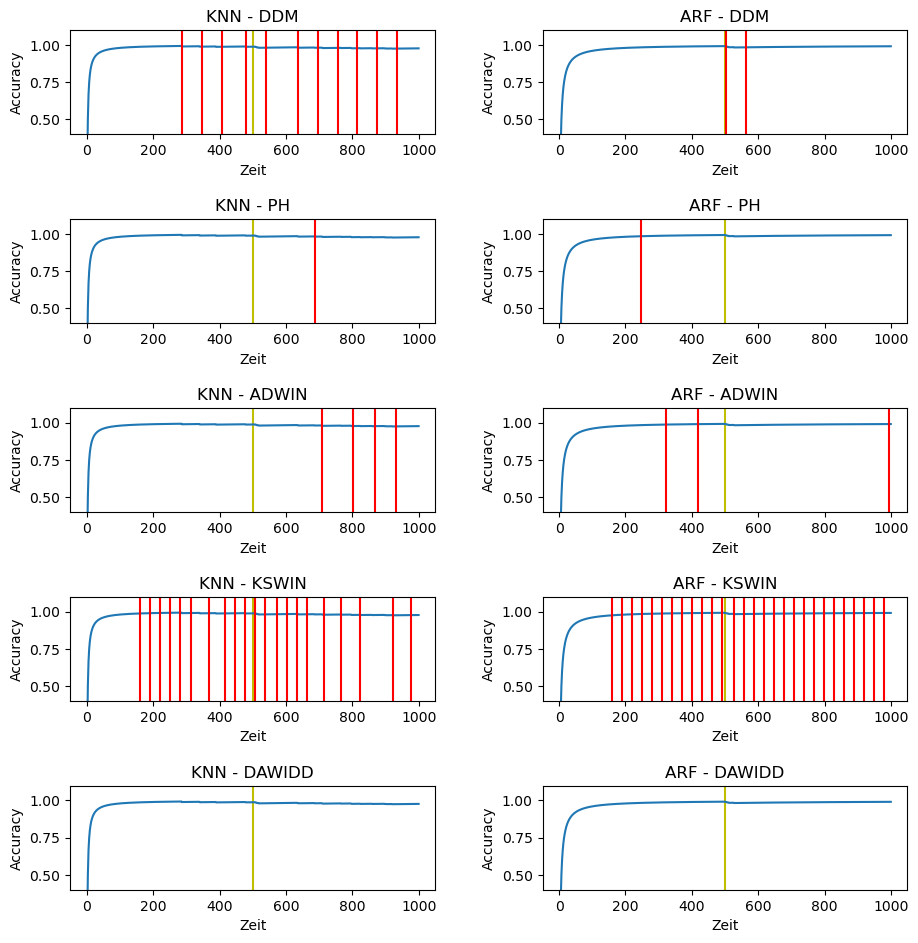

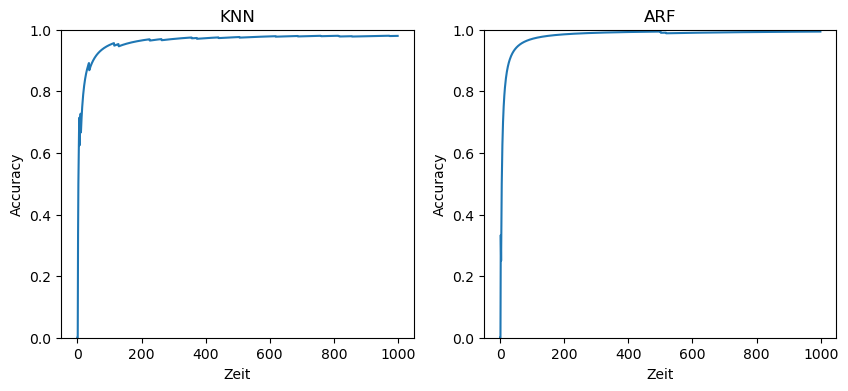

In [644]:
compute_online(dataset_1_enduse, 'Datensatz 1_enduse', days_1, True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 7.4 	 	 0.8 	 	 	 0.2 	 	 [15 15 15 15]
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 10.2 	 	 1.0 	 	 	 0.0 	 	 [35 14 26 33 48]
ARF 	 	 KSWIN	: 	 17.2 	 	 1.0 	 	 	 0.0 	 	 [62 77 21 30  2]
ARF 	 	 PH	: 	 2.8 	 	 0.2 	 	 	 0.8 	 	 [73]
DAWIDD 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 3.2 	 	 0.2 	 	 	 0.8 	 	 [79]
KNN 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [28 24 20 22 31]
KNN 	 	 KSWIN	: 	 13.4 	 	 1.0 	 	 	 0.0 	 	 [82  8 54 27 58]
KNN 	 	 PH	: 	 1.2 	 	 0.0 	 	 	 1.0 	 	 []
KNN Accuracy - 0.97
ARF Accuracy - 0.97
0.97 & 0.97
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 7.4 & 0.0 & 10.2 & 17.2 & 2.8 & 3.2 & 0.0 & 12.0 & 13.4 & 1.2 & 0.0
& Erkannt & 0.8 & 0.0 & 1.0 & 1.0 & 0.2 & 0.2 & 0.0 & 1.0 & 1

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


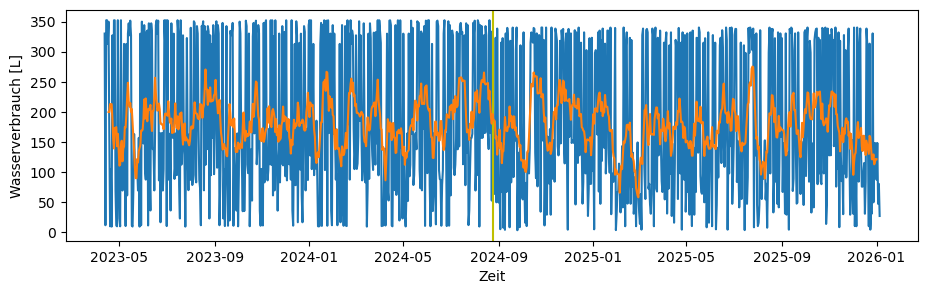

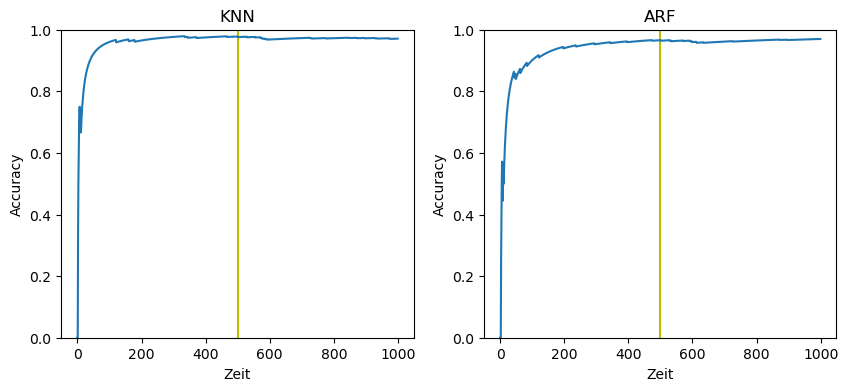

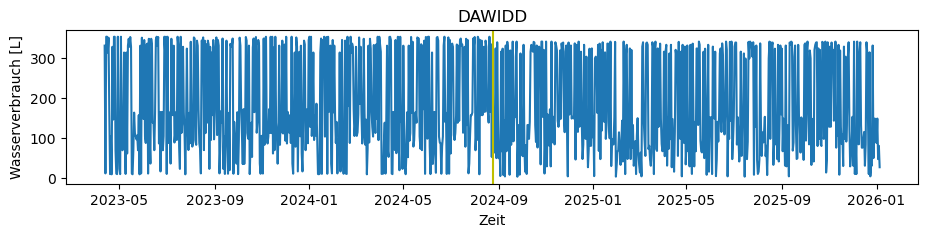

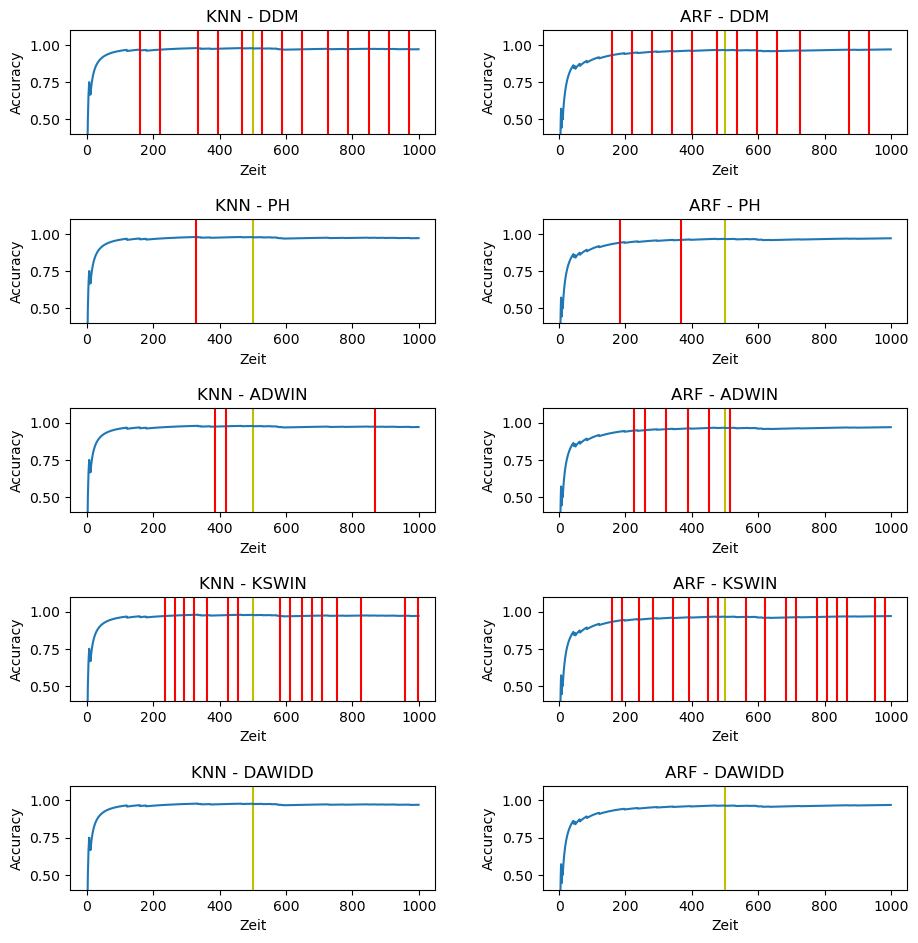

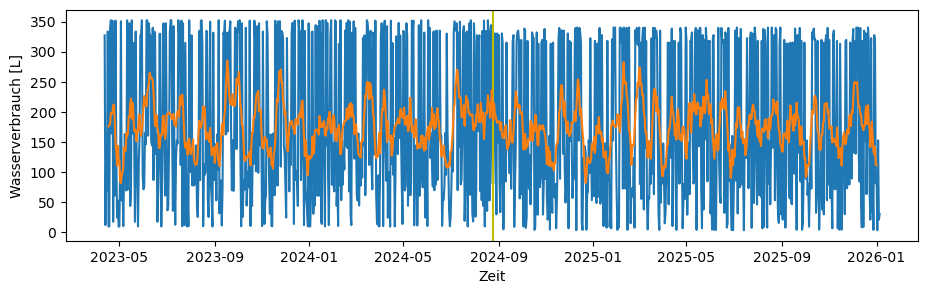

...

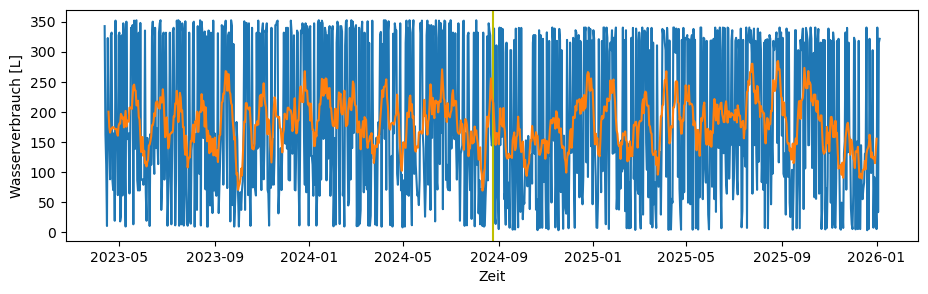

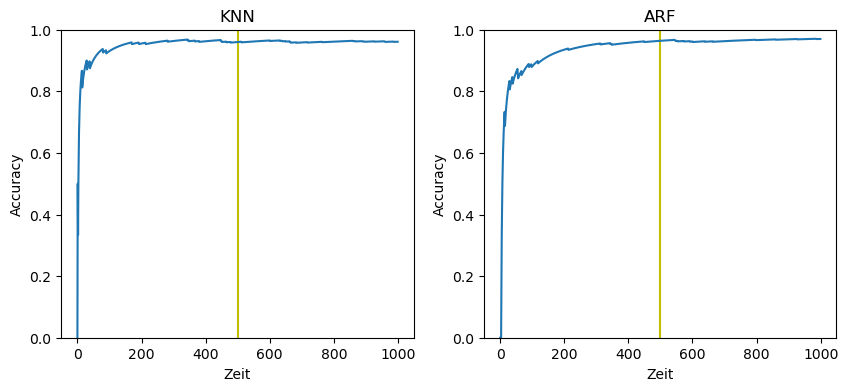

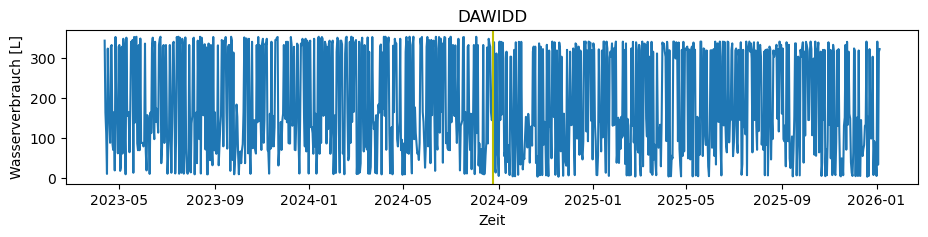

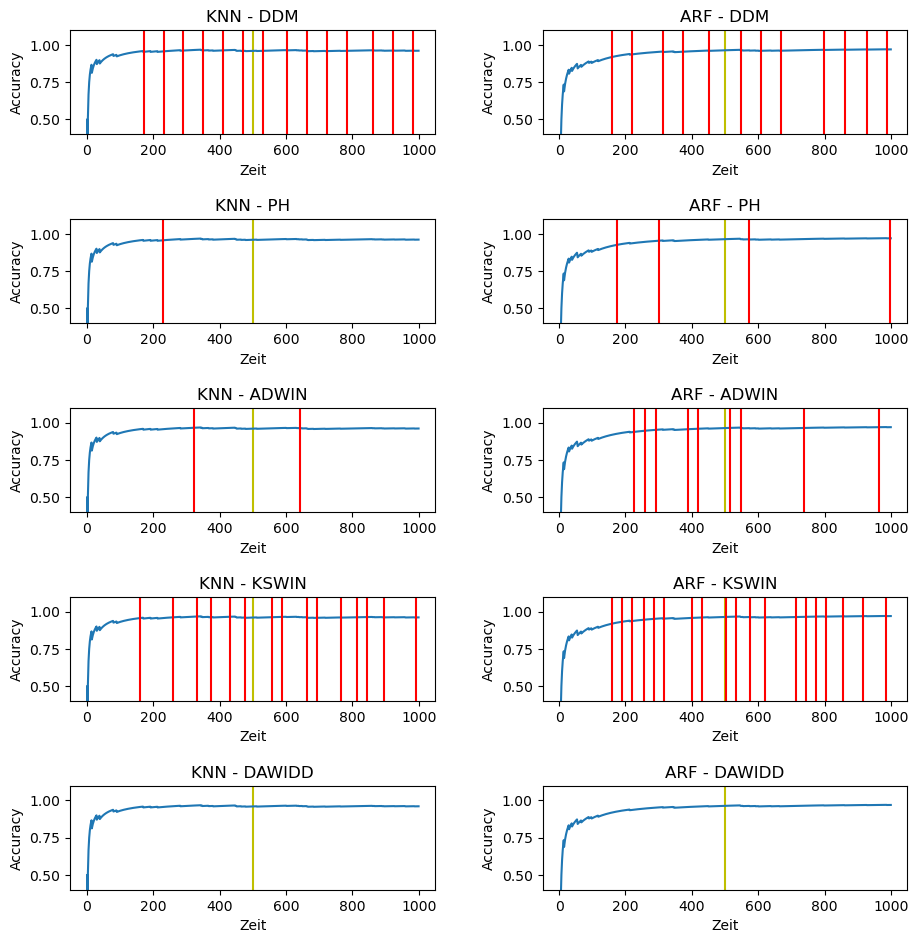

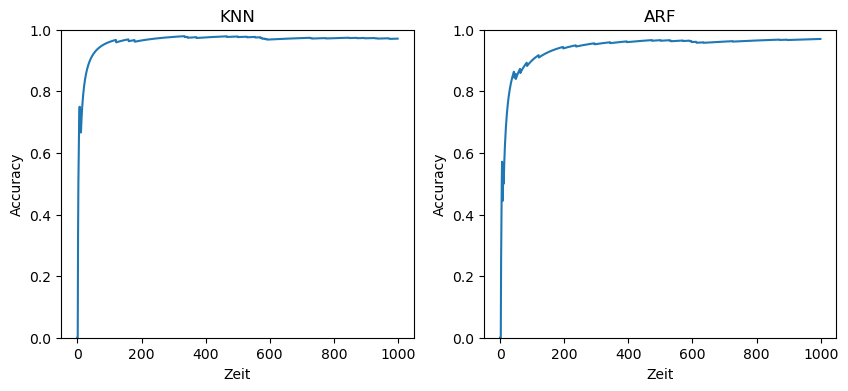

In [646]:
compute_online(dataset_2_enduse, 'Datensatz 2', days_2, True, True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 3.2 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 1.8 	 	 1.0 	 	 	 0.0 	 	 [2 4 2 2 2]
ARF 	 	 KSWIN	: 	 24.4 	 	 1.0 	 	 	 0.0 	 	 [28 29 28 28 27]
ARF 	 	 PH	: 	 1.0 	 	 0.2 	 	 	 0.8 	 	 [0]
DAWIDD 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 3.6 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 11.2 	 	 1.0 	 	 	 0.0 	 	 [28 24 36 49 19]
KNN 	 	 KSWIN	: 	 15.0 	 	 1.0 	 	 	 0.0 	 	 [57  1 81 86 58]
KNN 	 	 PH	: 	 1.6 	 	 0.0 	 	 	 1.0 	 	 []
KNN Accuracy - 0.97
ARF Accuracy - 0.99
0.97 & 0.99
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 3.2 & 0.0 & 1.8 & 24.4 & 1.0 & 3.6 & 0.0 & 11.2 & 15.0 & 1.6 & 0.0
& Erkannt & 0.0 & 0.0 & 1.0 & 1.0 & 0.2 & 0.0 & 0.0 & 1.0 & 1.0 & 0.0 & 0.0
& Nich

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


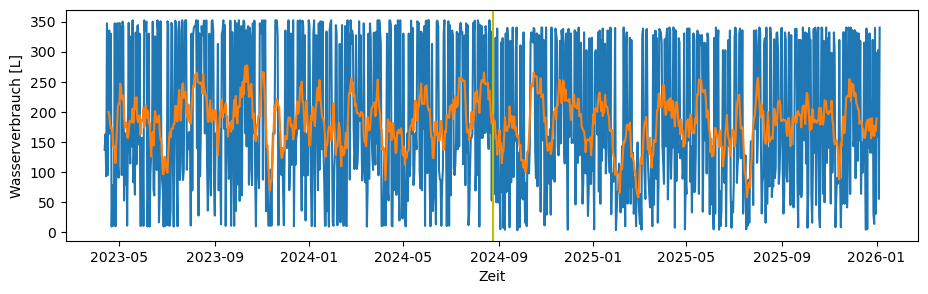

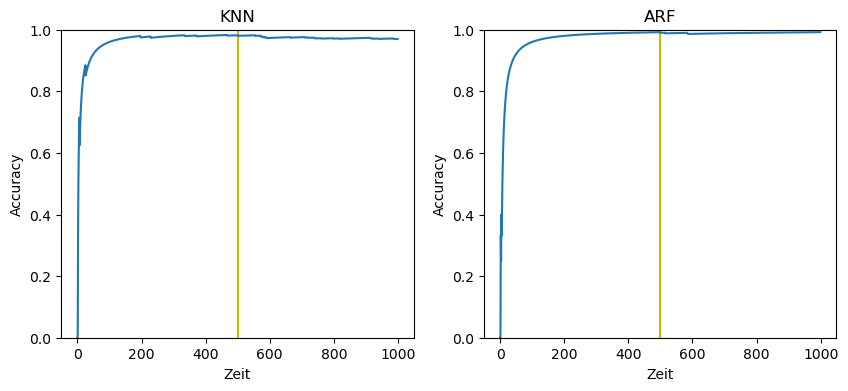

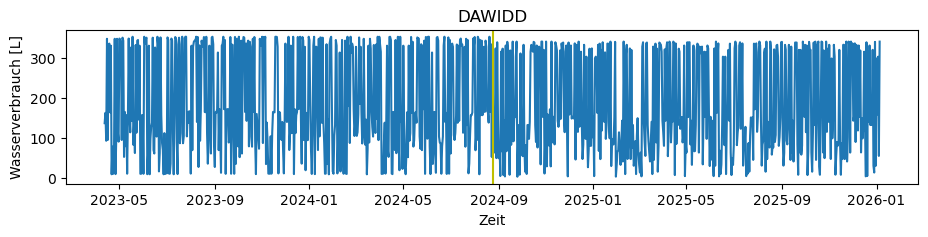

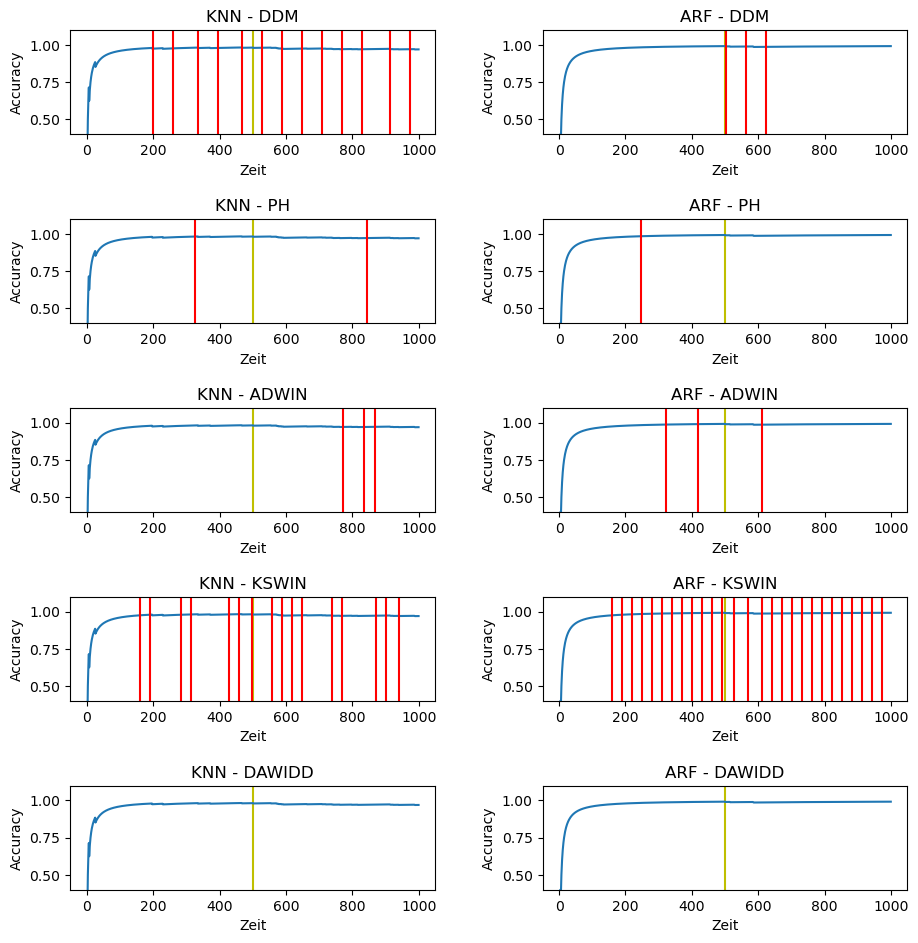

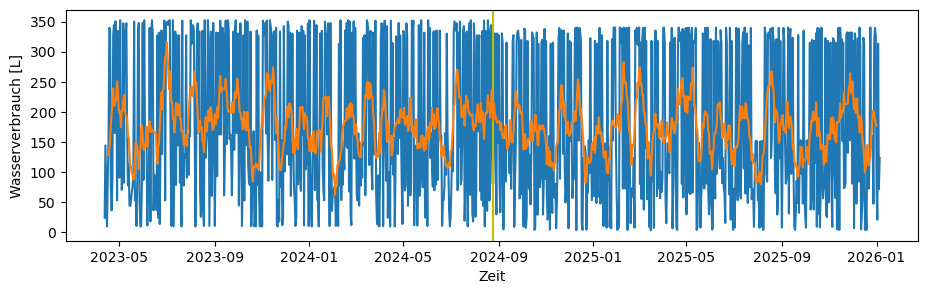

...

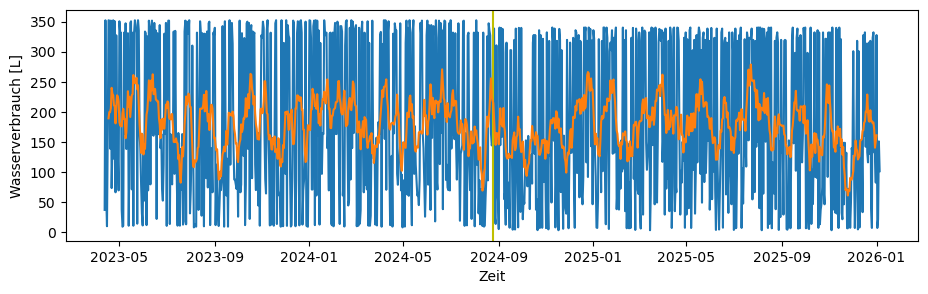

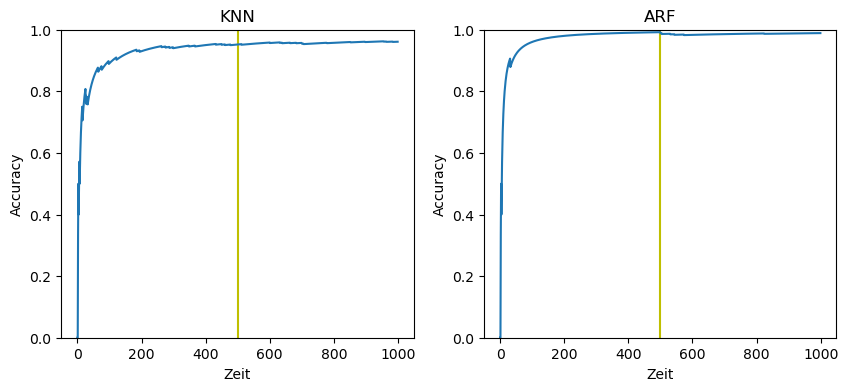

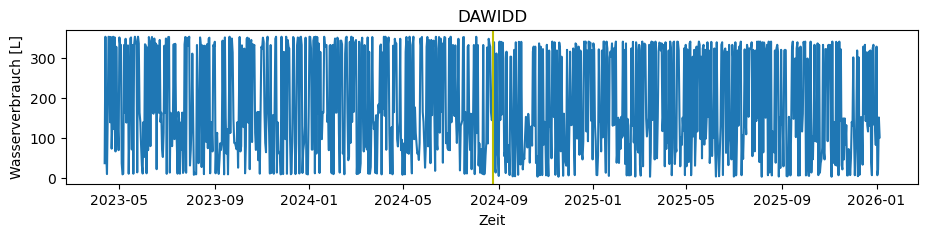

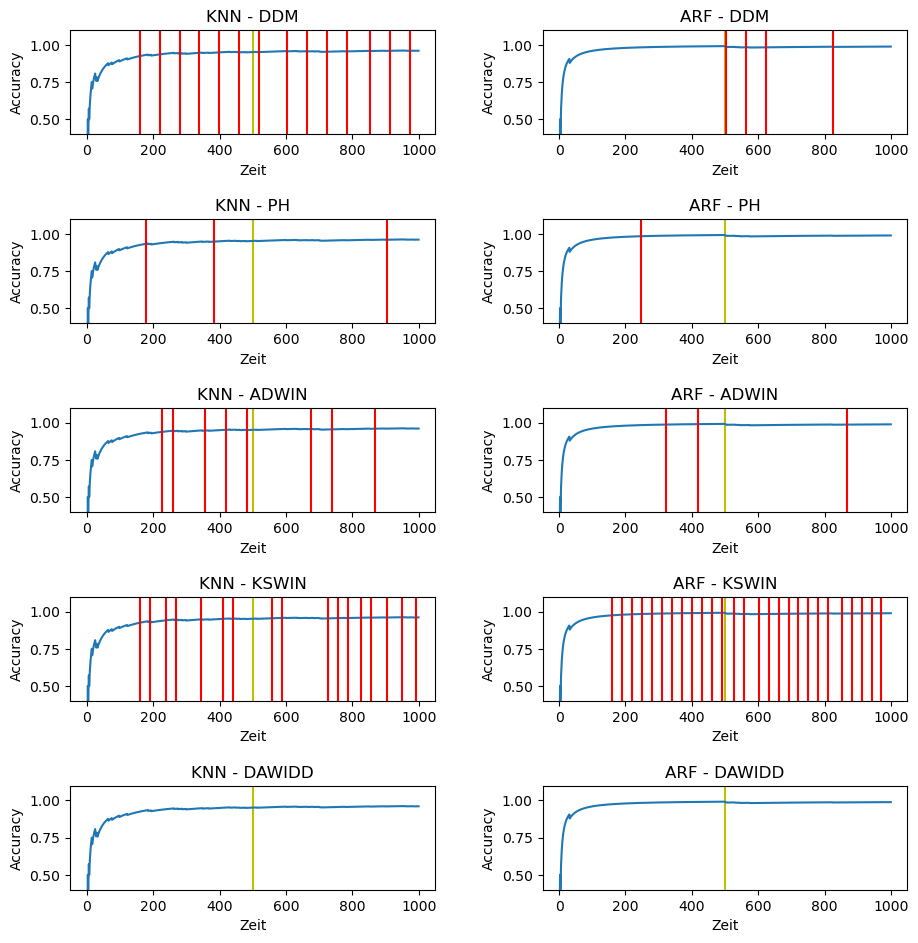

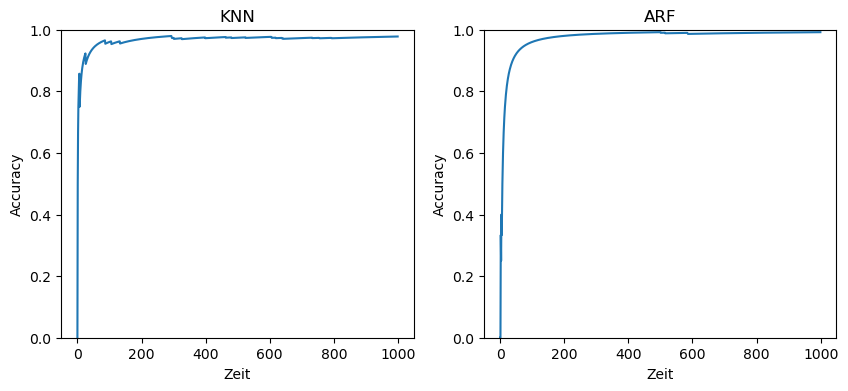

In [647]:
compute_online(dataset_2_enduse, 'Datensatz 2_enduse', days_2, True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 12.0 	 	 0.6 	 	 	 0.4 	 	 [15 79 15]
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [22 25 22 22 28]
ARF 	 	 KSWIN	: 	 14.8 	 	 1.0 	 	 	 0.0 	 	 [55 38 18 31 48]
ARF 	 	 PH	: 	 3.4 	 	 0.4 	 	 	 0.6 	 	 [97 62]
DAWIDD 	 	 DAWIDD	: 	 0.4 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 6.2 	 	 1.0 	 	 	 0.0 	 	 [47 79 15 15 47]
KNN 	 	 DAWIDD	: 	 0.6 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [22 25 22 27 21]
KNN 	 	 KSWIN	: 	 11.8 	 	 1.0 	 	 	 0.0 	 	 [12 19 54 20 48]
KNN 	 	 PH	: 	 2.6 	 	 0.0 	 	 	 1.0 	 	 []
KNN Accuracy - 0.62
ARF Accuracy - 0.66
0.62 & 0.66


C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 12.0 & 0.0 & 12.0 & 14.8 & 3.4 & 6.2 & 0.6 & 12.0 & 11.8 & 2.6 & 0.4
& Erkannt & 0.6 & 0.0 & 1.0 & 1.0 & 0.4 & 1.0 & 0.0 & 1.0 & 1.0 & 0.0 & 0.0
& Nicht & 0.4 & 1.0 & 0.0 & 0.0 & 0.6 & 0.0 & 1.0 & 0.0 & 0.0 & 1.0 & 1.0
& Delay & [15, 79, 15] & [] & [22, 25, 22, 22, 28] & [55, 38, 18, 31, 48] & [97, 62] & [47, 79, 15, 15, 47] & [] & [22, 25, 22, 27, 21] & [12, 19, 54, 20, 48] & [] & []


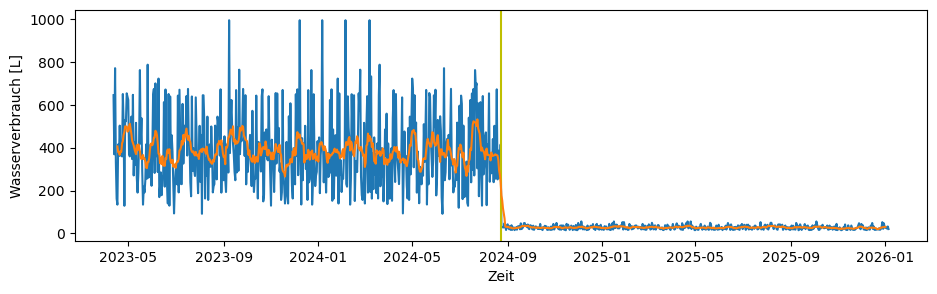

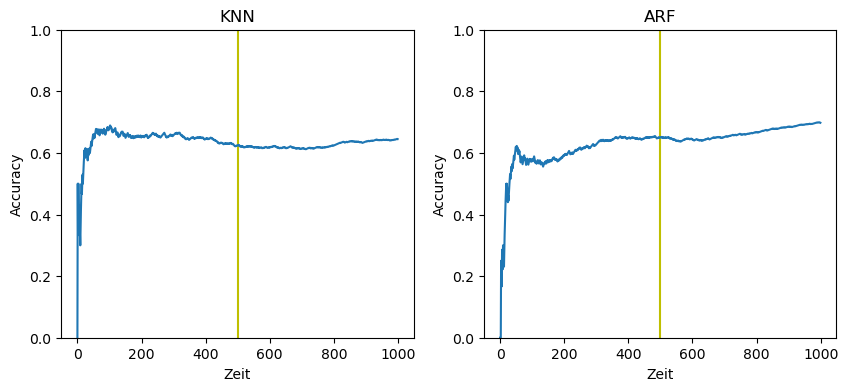

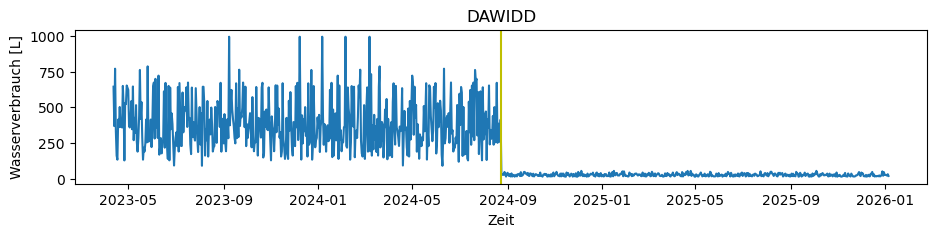

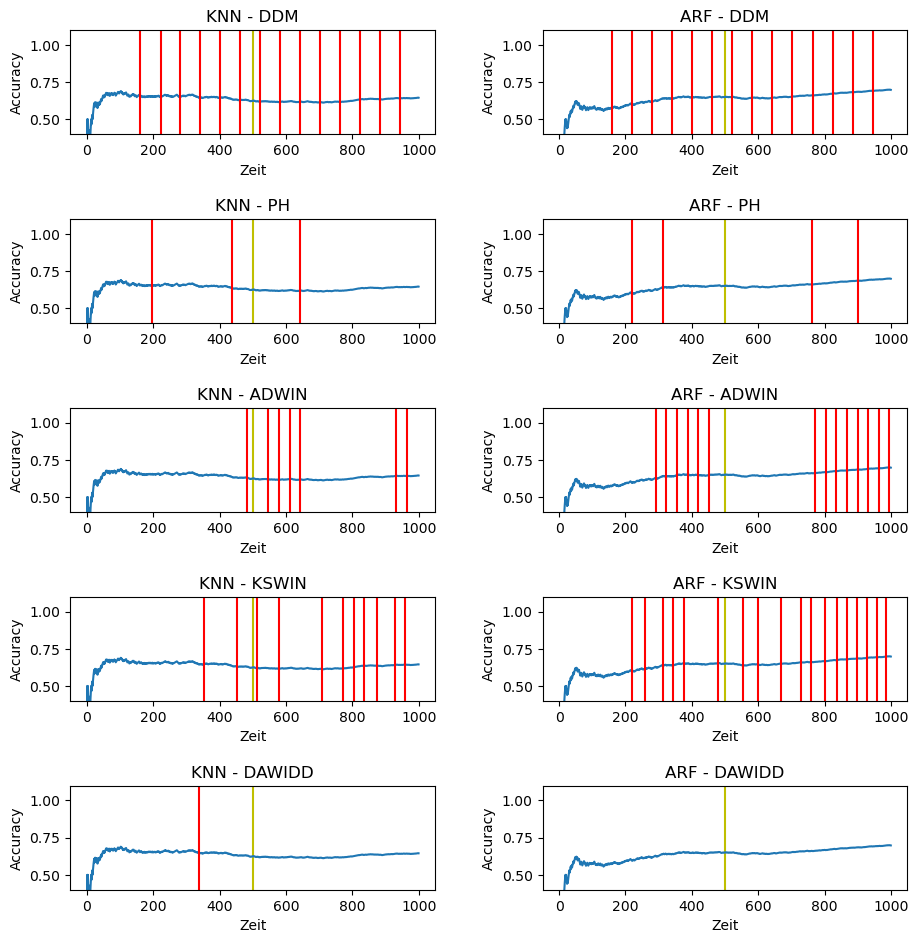

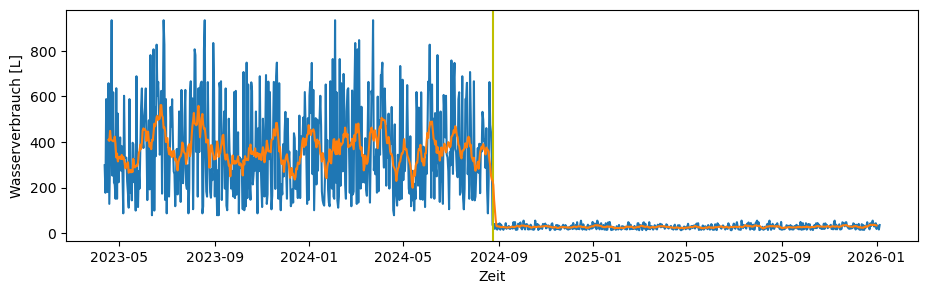

...

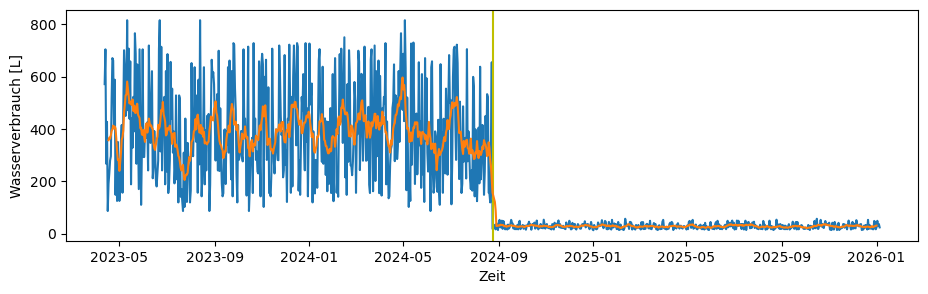

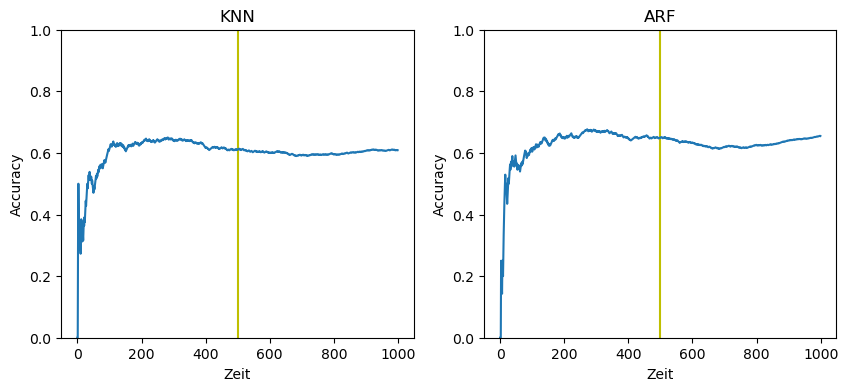

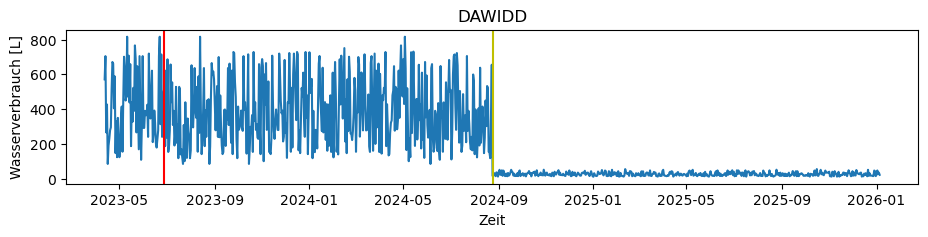

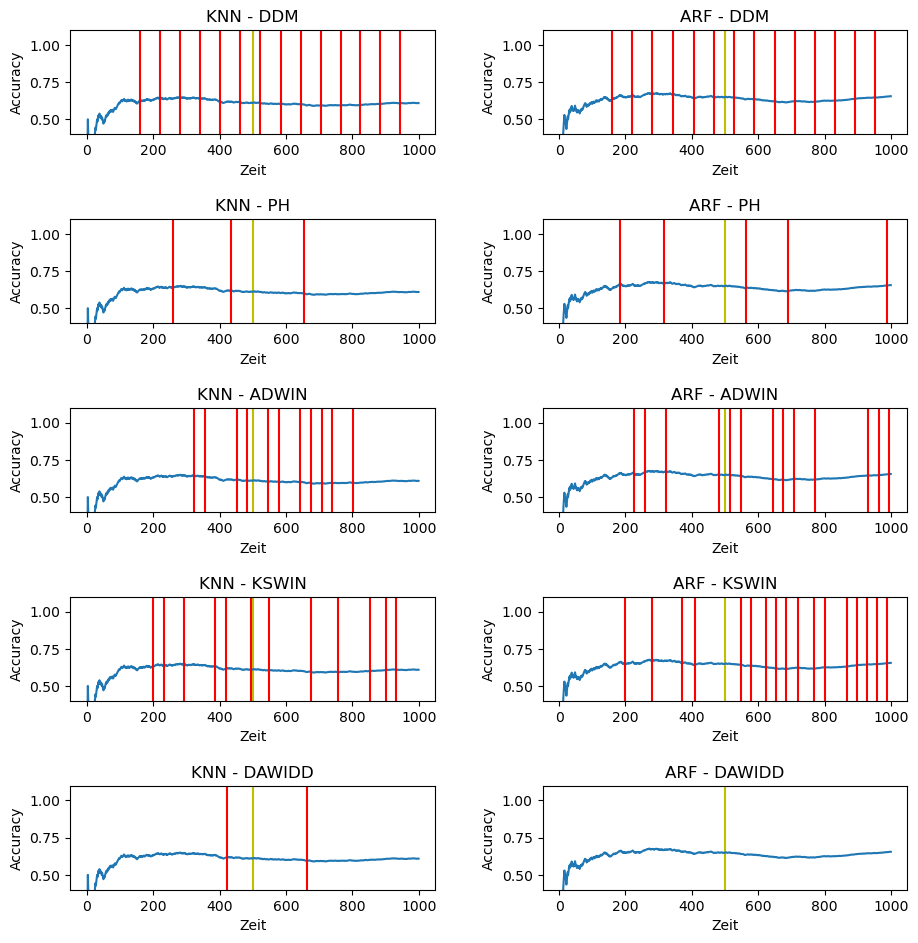

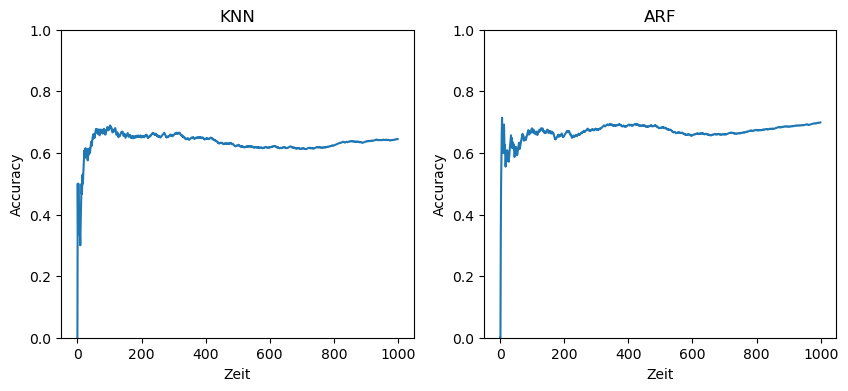

In [649]:
compute_online(dataset_3_enduse, 'Datensatz 3', days = days_3, print_plots = True, sum_ = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 7.2 	 	 0.6 	 	 	 0.4 	 	 [79 79 79]
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 8.2 	 	 1.0 	 	 	 0.0 	 	 [ 2 48 38 14  1]
ARF 	 	 KSWIN	: 	 18.4 	 	 1.0 	 	 	 0.0 	 	 [27 28 32 29 27]
ARF 	 	 PH	: 	 2.2 	 	 0.4 	 	 	 0.6 	 	 [77 91]
DAWIDD 	 	 DAWIDD	: 	 0.0 	 	 0.2 	 	 	 0.8 	 	 [18]
KNN 	 	 ADWIN	: 	 12.8 	 	 0.8 	 	 	 0.2 	 	 [15 47 15 15]
KNN 	 	 DAWIDD	: 	 0.2 	 	 0.4 	 	 	 0.6 	 	 [26  2]
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [20 25 20 25 24]
KNN 	 	 KSWIN	: 	 17.2 	 	 1.0 	 	 	 0.0 	 	 [11 11  0 20 54]
KNN 	 	 PH	: 	 4.2 	 	 0.0 	 	 	 1.0 	 	 []
KNN Accuracy - 0.75
ARF Accuracy - 0.96
0.75 & 0.96


C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 7.2 & 0.0 & 8.2 & 18.4 & 2.2 & 12.8 & 0.2 & 12.0 & 17.2 & 4.2 & 0.0
& Erkannt & 0.6 & 0.0 & 1.0 & 1.0 & 0.4 & 0.8 & 0.4 & 1.0 & 1.0 & 0.0 & 0.2
& Nicht & 0.4 & 1.0 & 0.0 & 0.0 & 0.6 & 0.2 & 0.6 & 0.0 & 0.0 & 1.0 & 0.8
& Delay & [79, 79, 79] & [] & [2, 48, 38, 14, 1] & [27, 28, 32, 29, 27] & [77, 91] & [15, 47, 15, 15] & [26, 2] & [20, 25, 20, 25, 24] & [11, 11, 0, 20, 54] & [] & [18]


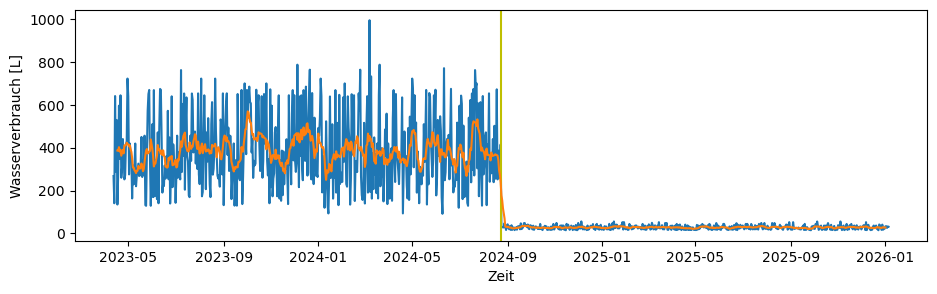

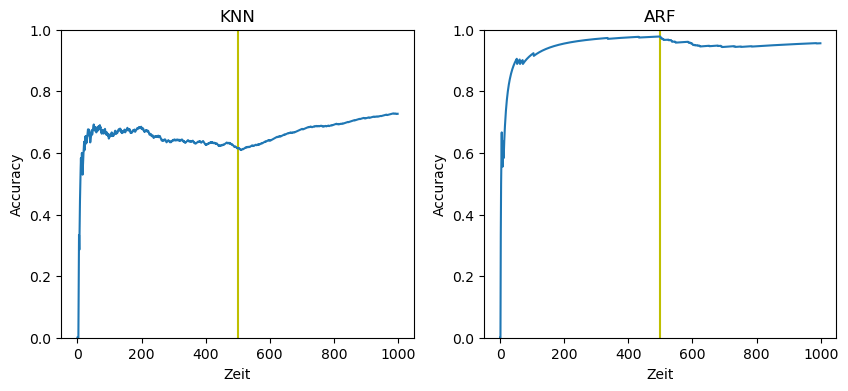

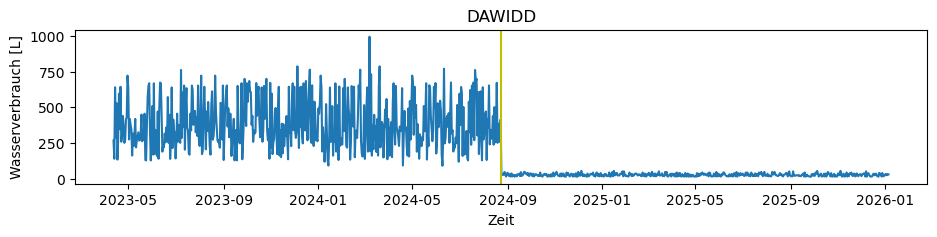

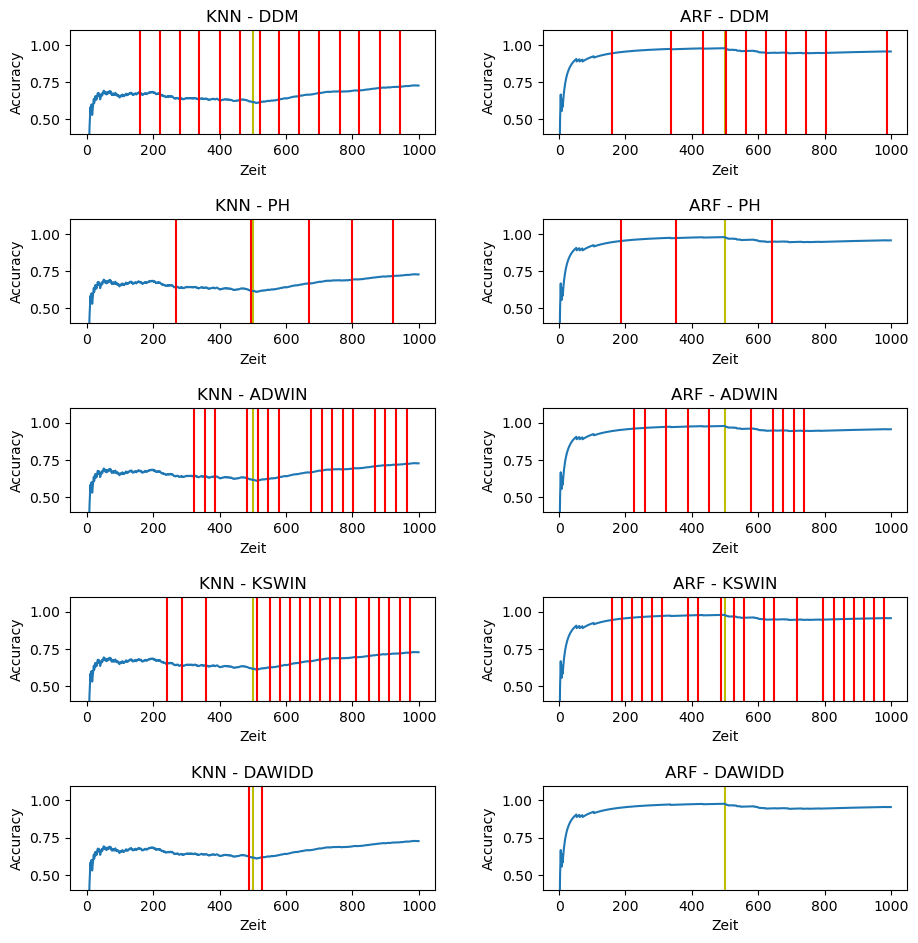

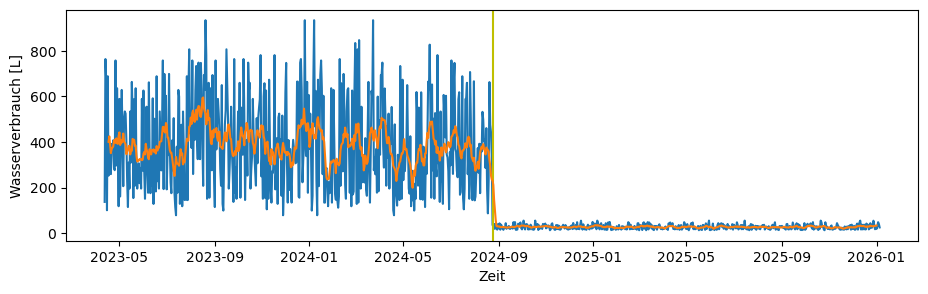

...

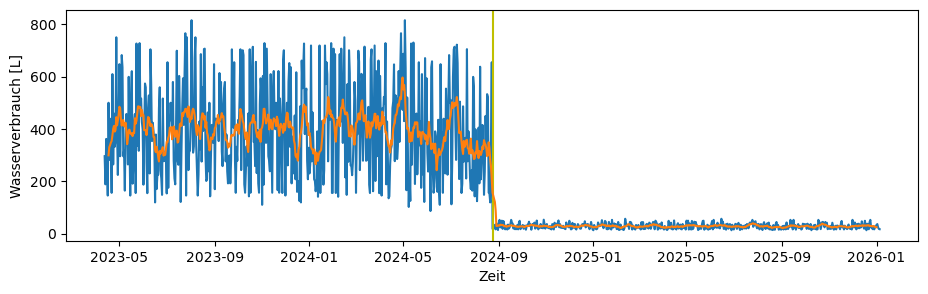

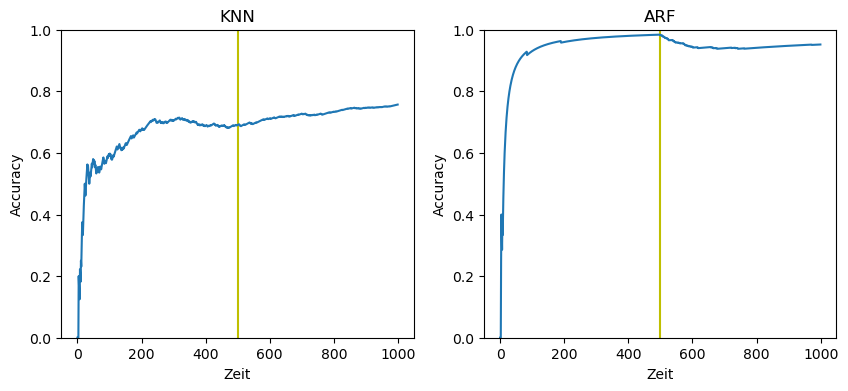

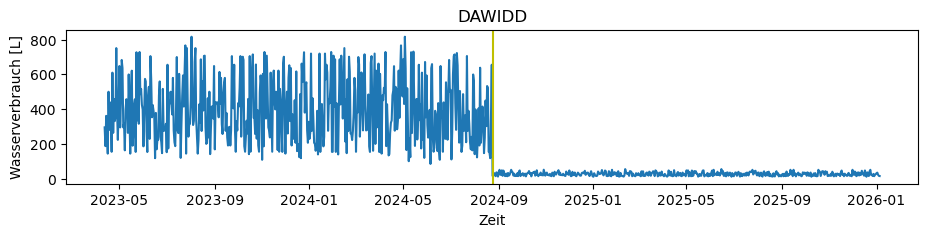

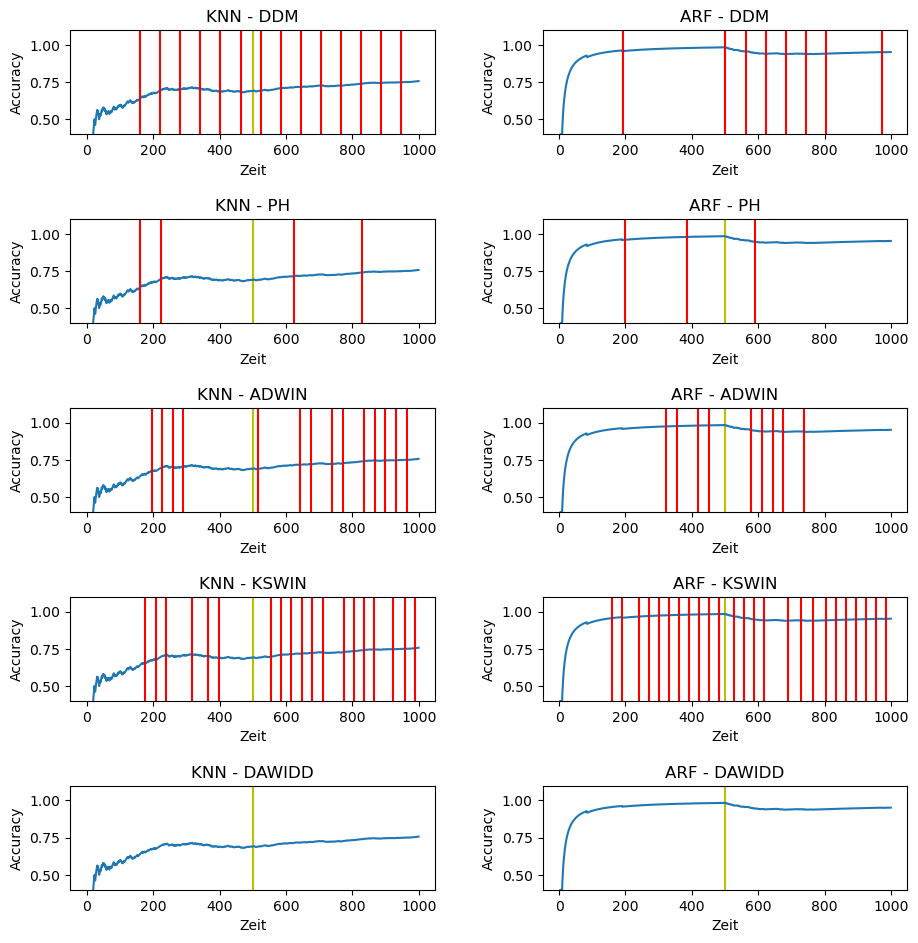

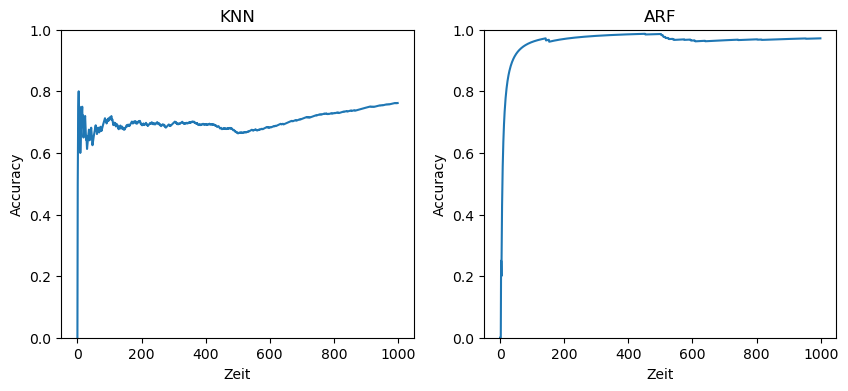

In [650]:
compute_online(dataset_3_enduse, 'Datensatz 3_enduse', days = days_3, print_plots = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 13.8 	 	 0.4 	 	 	 0.6 	 	 [47 79]
ARF 	 	 DAWIDD	: 	 0.4 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [23 21 21 23 19]
ARF 	 	 KSWIN	: 	 16.6 	 	 1.0 	 	 	 0.0 	 	 [65  6 52  8 14]
ARF 	 	 PH	: 	 4.6 	 	 0.2 	 	 	 0.8 	 	 [33]
DAWIDD 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 8.0 	 	 0.8 	 	 	 0.2 	 	 [47 47 15 47]
KNN 	 	 DAWIDD	: 	 0.6 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [25 21 19 20 24]
KNN 	 	 KSWIN	: 	 13.8 	 	 1.0 	 	 	 0.0 	 	 [34 64 46 53 10]
KNN 	 	 PH	: 	 2.8 	 	 0.4 	 	 	 0.6 	 	 [14  6]
KNN Accuracy - 0.6
ARF Accuracy - 0.71
0.6 & 0.71
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 13.8 & 0.4 & 12.0 & 16.6 & 4.6 & 8.0 & 0.6 & 12.0 & 13.8 & 2.8 & 0.0
& Erkannt & 0.4 & 0.0 & 1.0 & 1.0 & 0.2 & 0.8 & 0.0 &

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


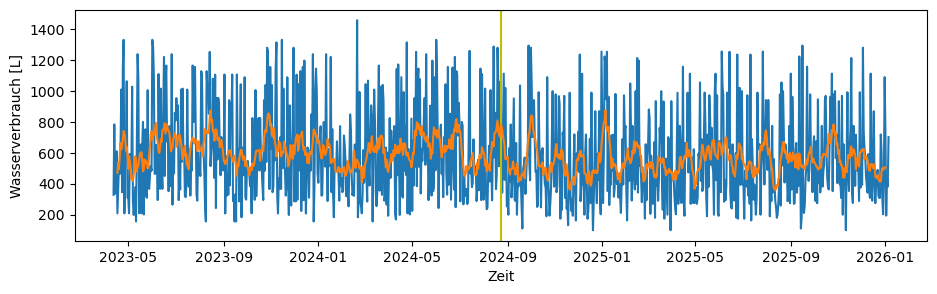

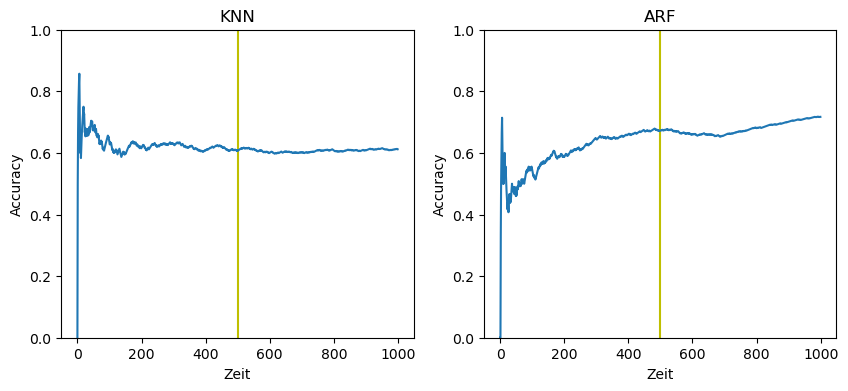

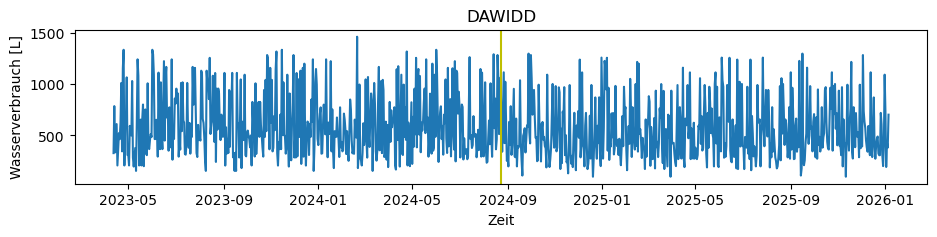

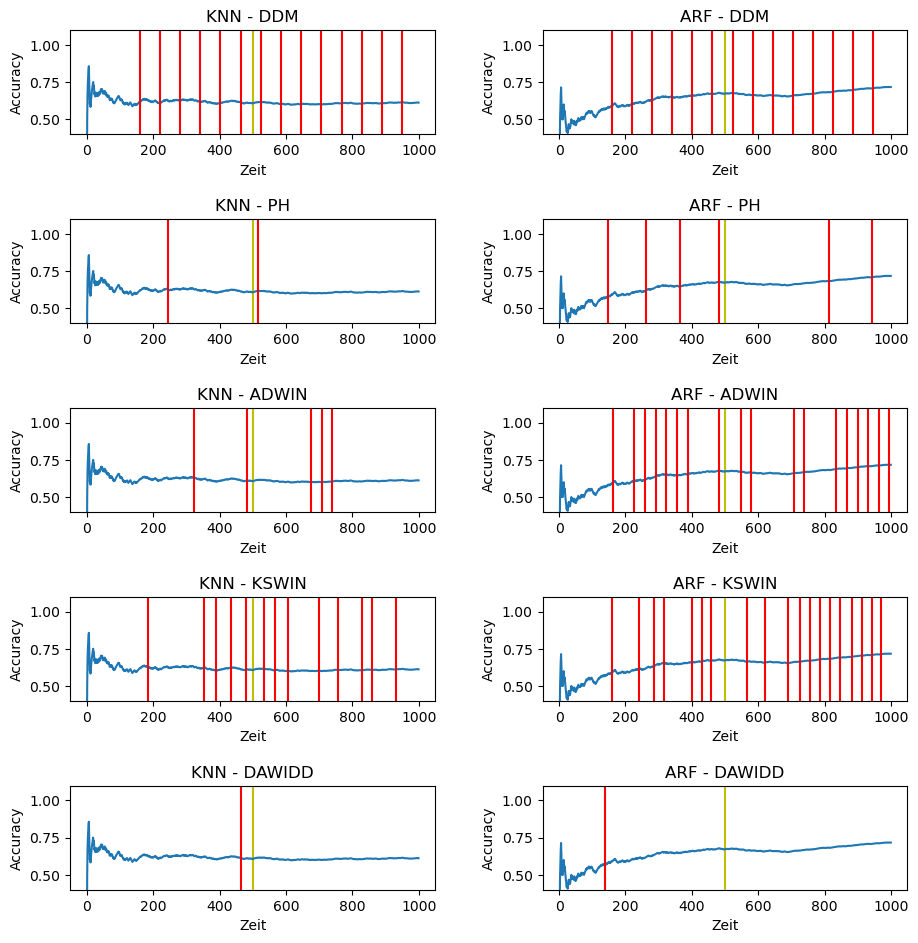

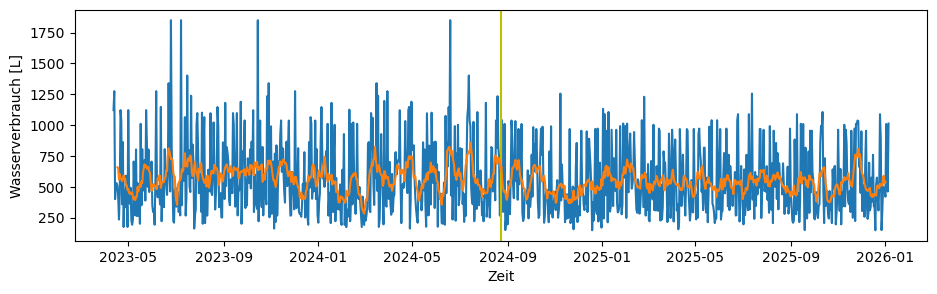

...

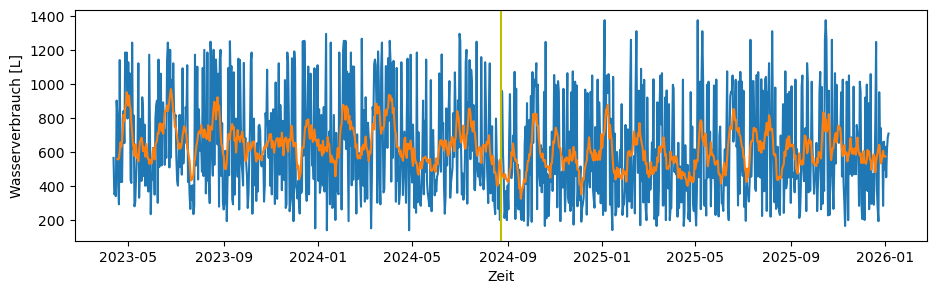

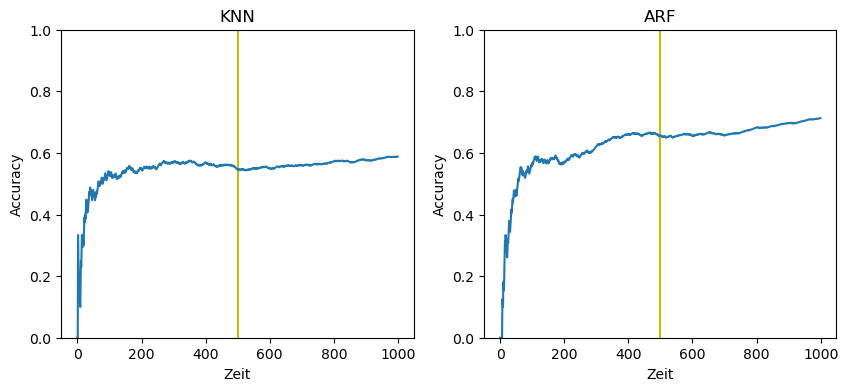

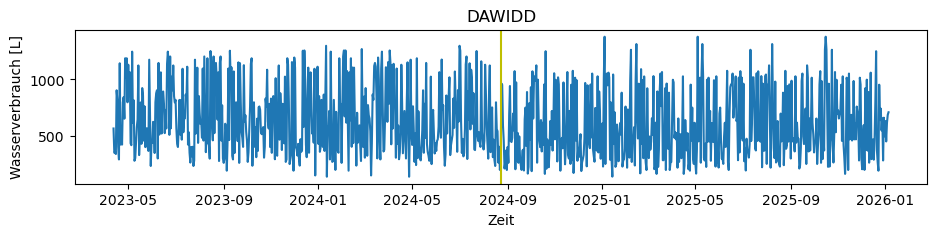

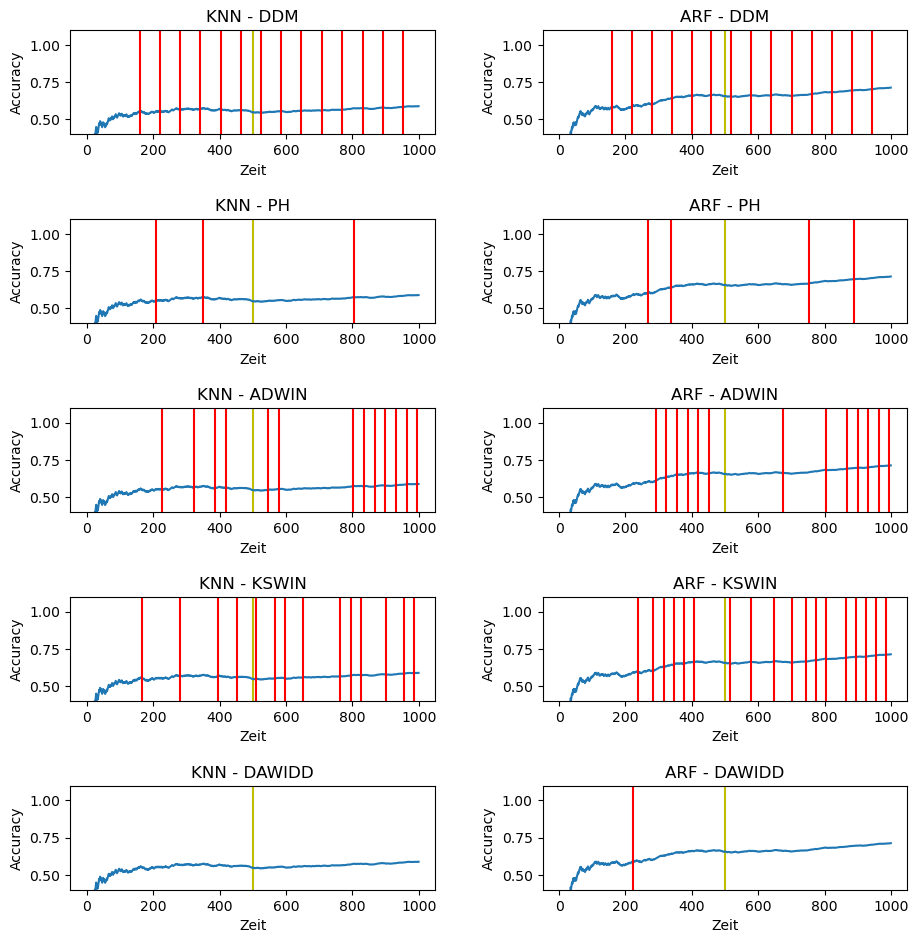

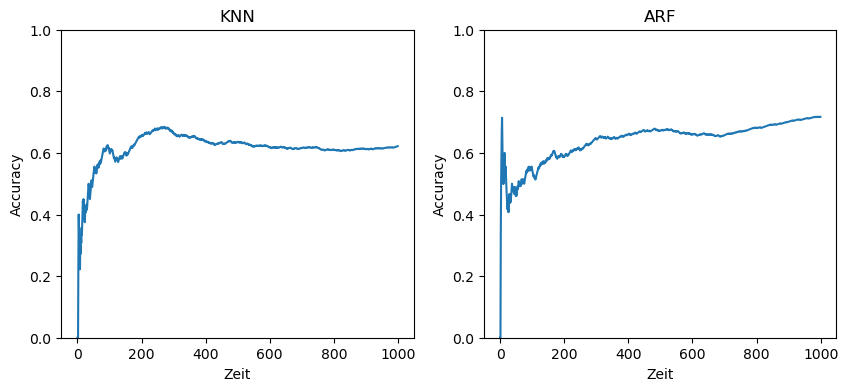

In [652]:
compute_online(dataset_4_enduse, 'Datensatz 4', days = days_4, print_plots = True, sum_ = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 8.0 	 	 0.4 	 	 	 0.6 	 	 [15 47]
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 5.0 	 	 0.2 	 	 	 0.8 	 	 [24]
ARF 	 	 KSWIN	: 	 22.8 	 	 1.0 	 	 	 0.0 	 	 [ 4 23 14  2 50]
ARF 	 	 PH	: 	 2.6 	 	 0.0 	 	 	 1.0 	 	 []
DAWIDD 	 	 DAWIDD	: 	 0.2 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 9.2 	 	 1.0 	 	 	 0.0 	 	 [15 47 79 15 47]
KNN 	 	 DAWIDD	: 	 0.4 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [22 21 26 23 25]
KNN 	 	 KSWIN	: 	 11.2 	 	 1.0 	 	 	 0.0 	 	 [43 11 13 48 13]
KNN 	 	 PH	: 	 2.6 	 	 0.6 	 	 	 0.4 	 	 [48  5  8]
KNN Accuracy - 0.68
ARF Accuracy - 0.99
0.68 & 0.99
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 8.0 & 0.0 & 5.0 & 22.8 & 2.6 & 9.2 & 0.4 & 12.0 & 11.2 & 2.6 & 0.2
& Erkannt & 0.4 & 0.0 & 0.2 & 1.0 & 0.0 & 1.0 & 0.0 & 1.0 & 1.0

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


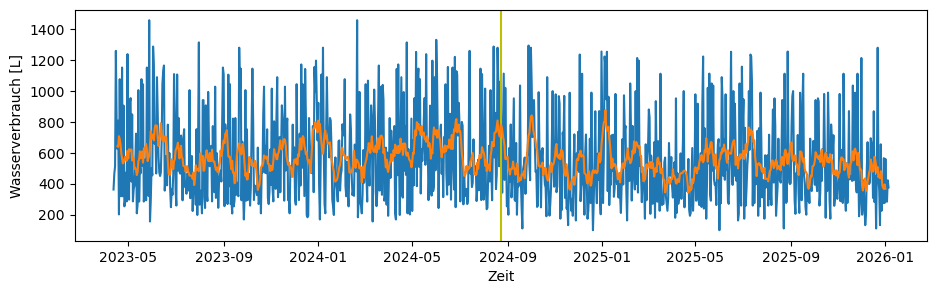

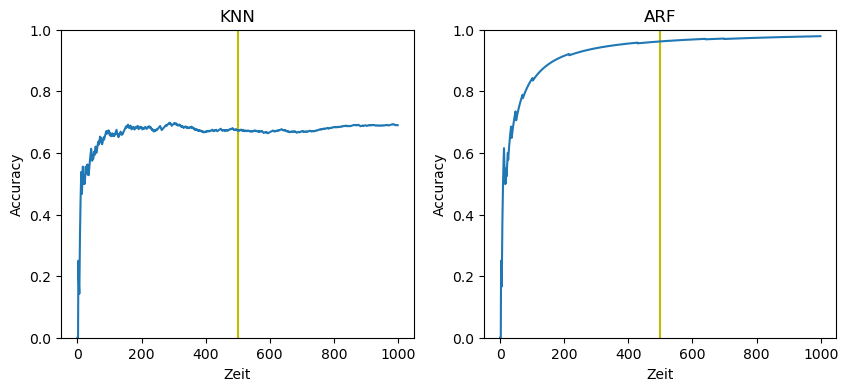

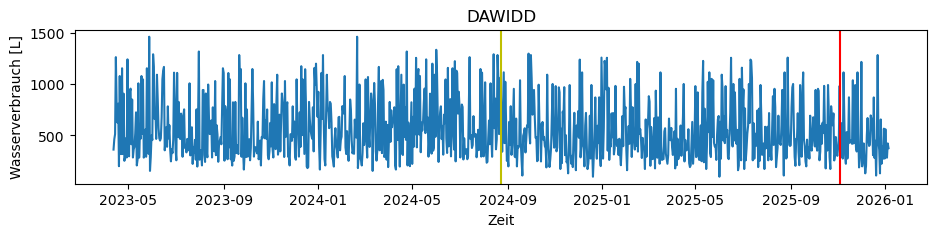

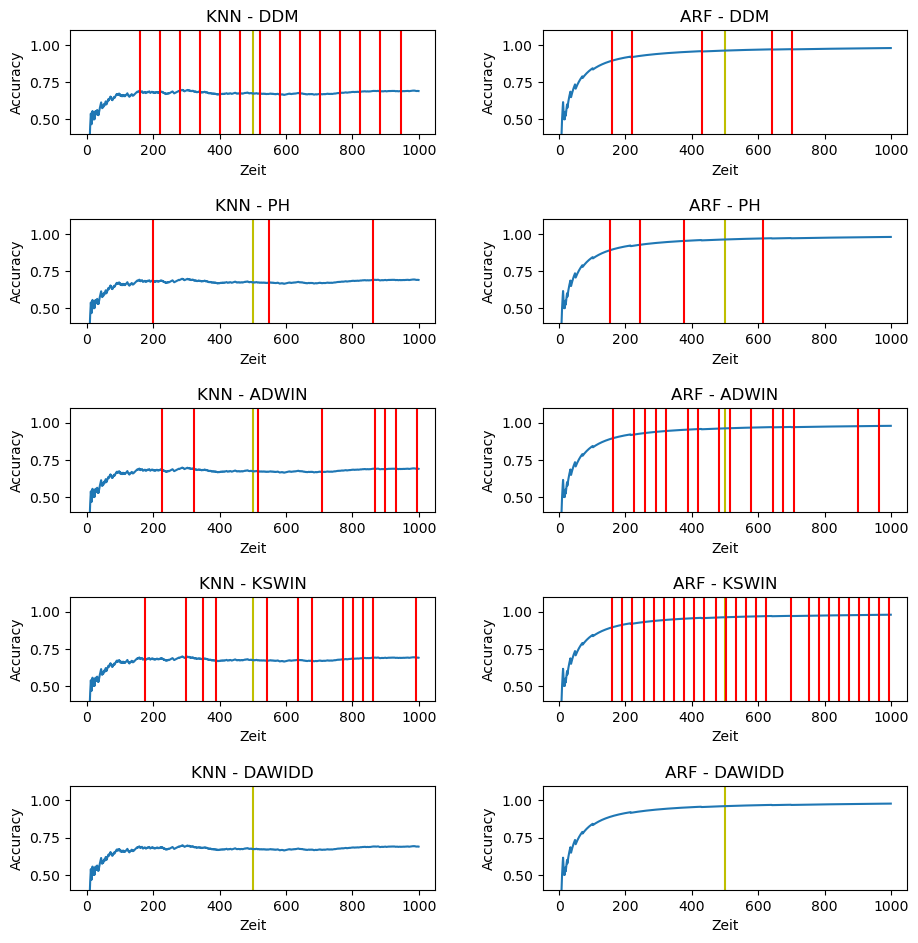

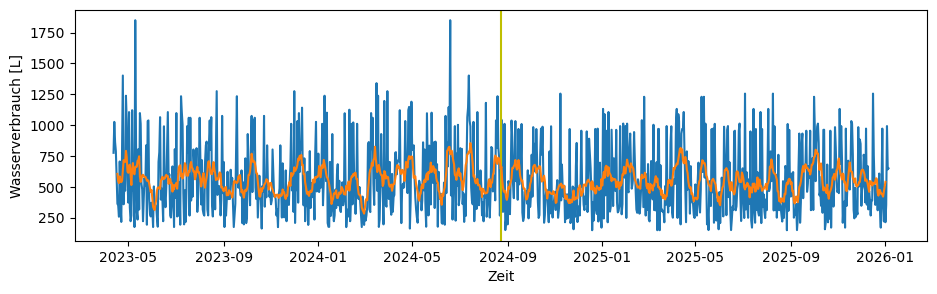

...

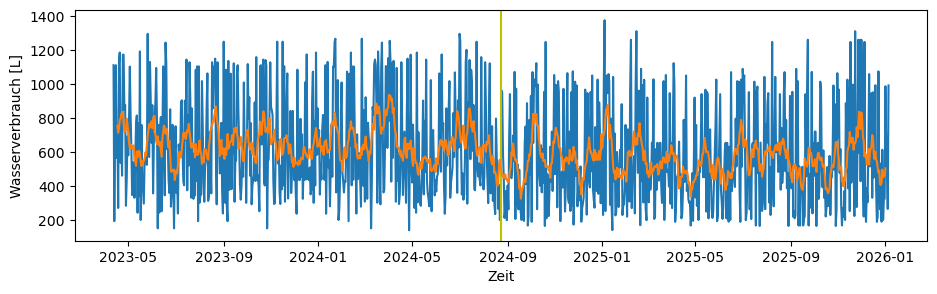

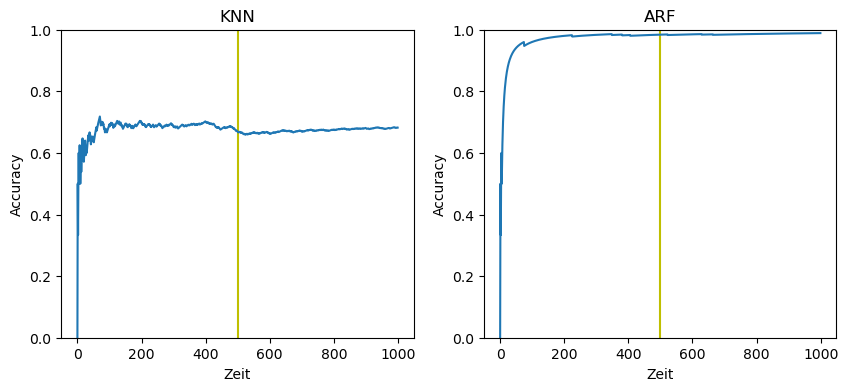

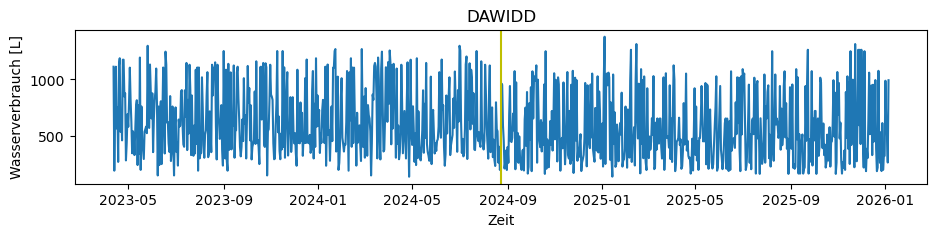

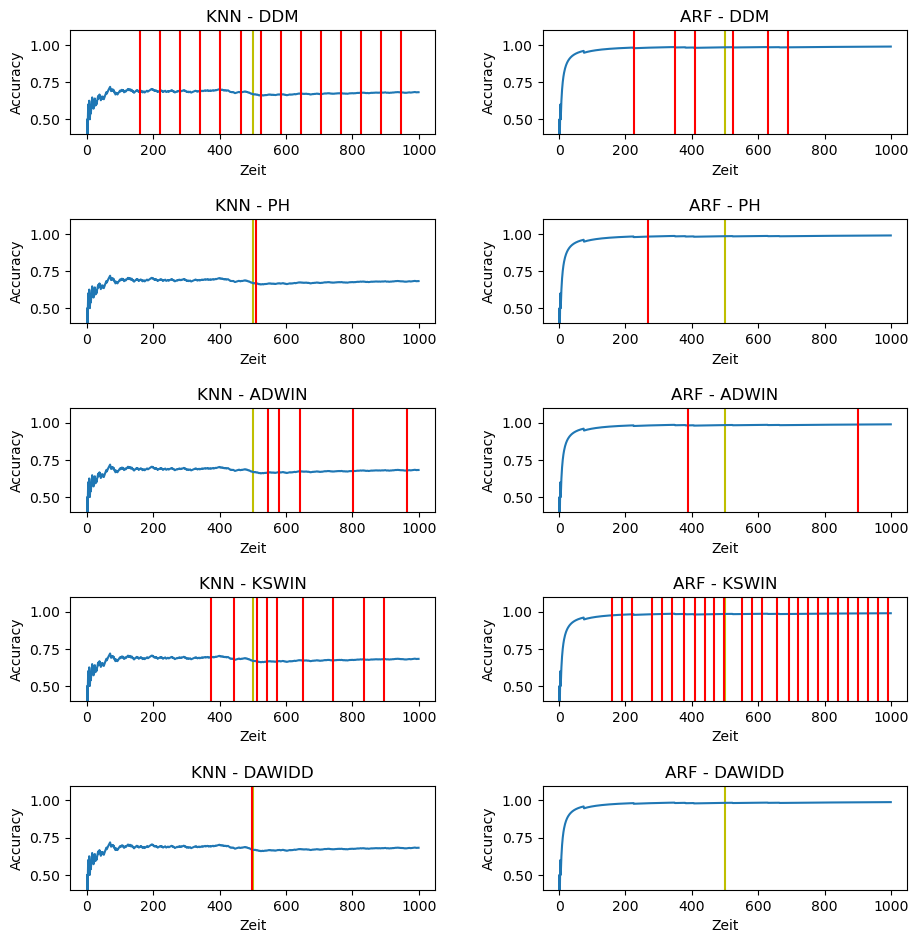

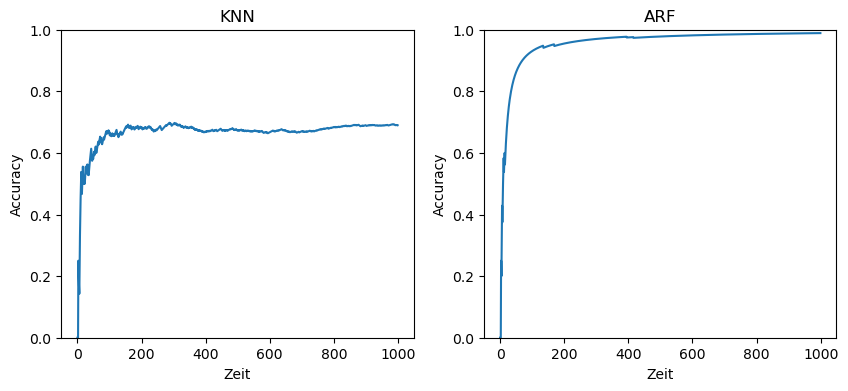

In [653]:
compute_online(dataset_4_enduse, 'Datensatz 4_enduse', days = days_4, print_plots = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 13.6 	 	 0.6 	 	 	 0.4 	 	 [79 79 47]
ARF 	 	 DAWIDD	: 	 0.2 	 	 0.4 	 	 	 0.6 	 	 [24 50]
ARF 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [21 22 21 23 22]
ARF 	 	 KSWIN	: 	 17.4 	 	 1.0 	 	 	 0.0 	 	 [11 12  7 87  4]
ARF 	 	 PH	: 	 3.6 	 	 0.6 	 	 	 0.4 	 	 [33 67 87]
DAWIDD 	 	 DAWIDD	: 	 0.2 	 	 0.2 	 	 	 0.8 	 	 [28]
KNN 	 	 ADWIN	: 	 8.0 	 	 1.0 	 	 	 0.0 	 	 [15 47 15 15 15]
KNN 	 	 DAWIDD	: 	 1.0 	 	 0.2 	 	 	 0.8 	 	 [65]
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [33 27 24 23 22]
KNN 	 	 KSWIN	: 	 12.6 	 	 1.0 	 	 	 0.0 	 	 [28 60 17 38 27]
KNN 	 	 PH	: 	 2.0 	 	 1.0 	 	 	 0.0 	 	 [48 96 61 52 41]
KNN Accuracy - 0.57
ARF Accuracy - 0.67
0.57 & 0.67


C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 13.6 & 0.2 & 12.0 & 17.4 & 3.6 & 8.0 & 1.0 & 12.0 & 12.6 & 2.0 & 0.2
& Erkannt & 0.6 & 0.4 & 1.0 & 1.0 & 0.6 & 1.0 & 0.2 & 1.0 & 1.0 & 1.0 & 0.2
& Nicht & 0.4 & 0.6 & 0.0 & 0.0 & 0.4 & 0.0 & 0.8 & 0.0 & 0.0 & 0.0 & 0.8
& Delay & [79, 79, 47] & [24, 50] & [21, 22, 21, 23, 22] & [11, 12, 7, 87, 4] & [33, 67, 87] & [15, 47, 15, 15, 15] & [65] & [33, 27, 24, 23, 22] & [28, 60, 17, 38, 27] & [48, 96, 61, 52, 41] & [28]


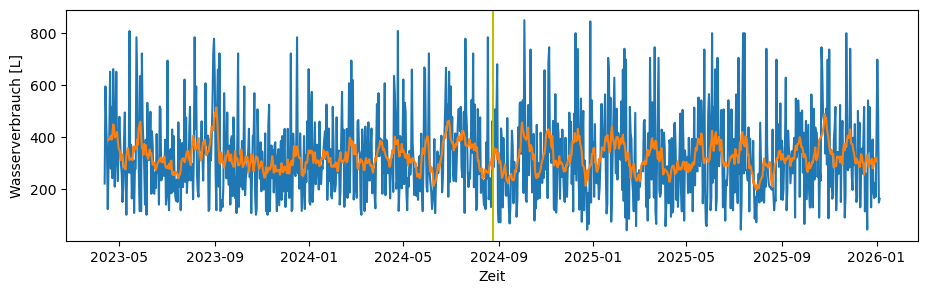

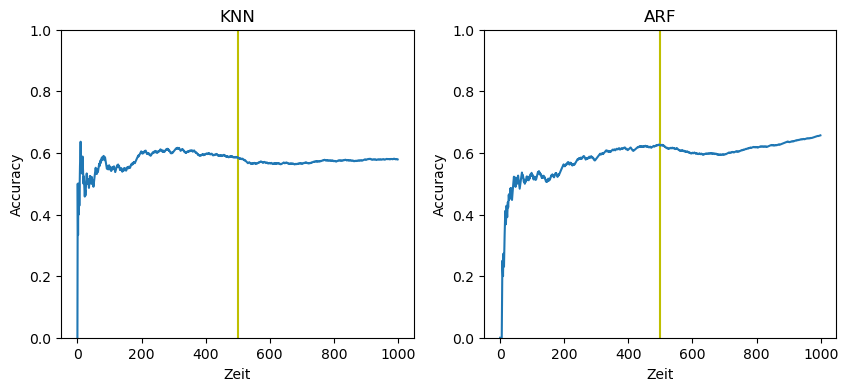

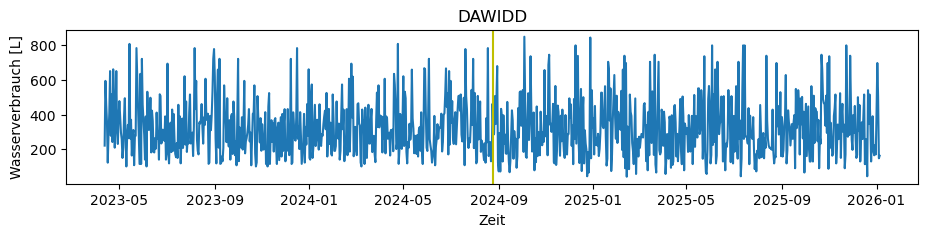

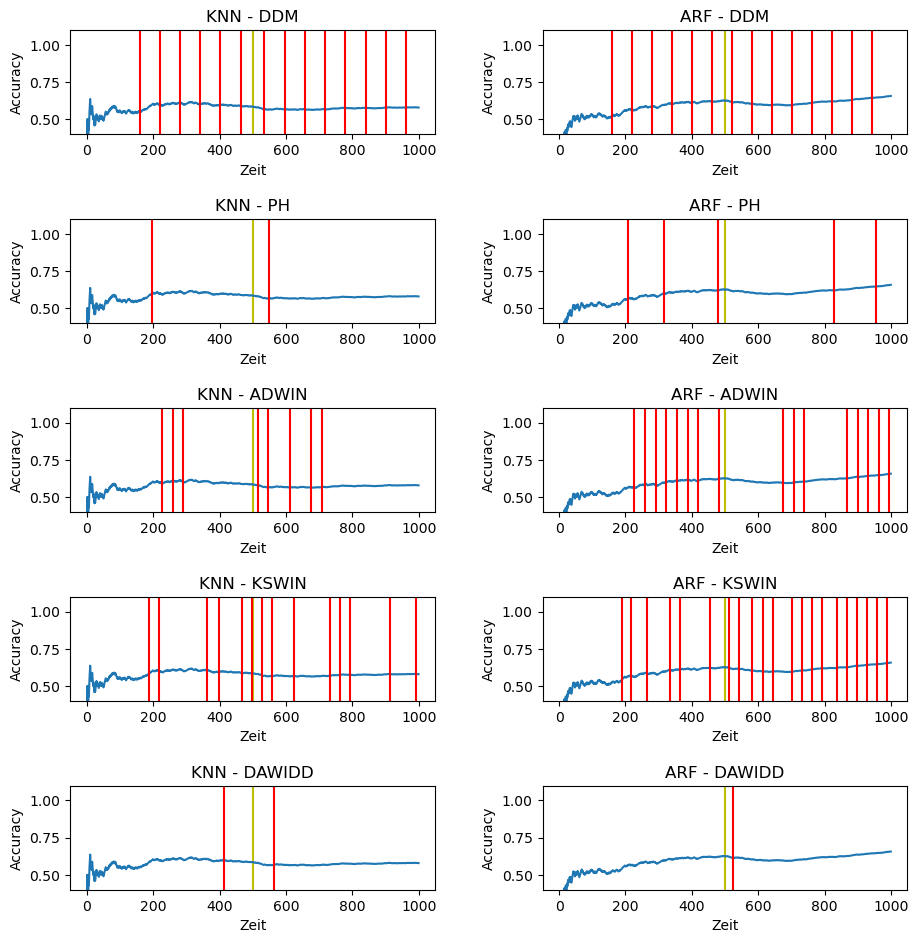

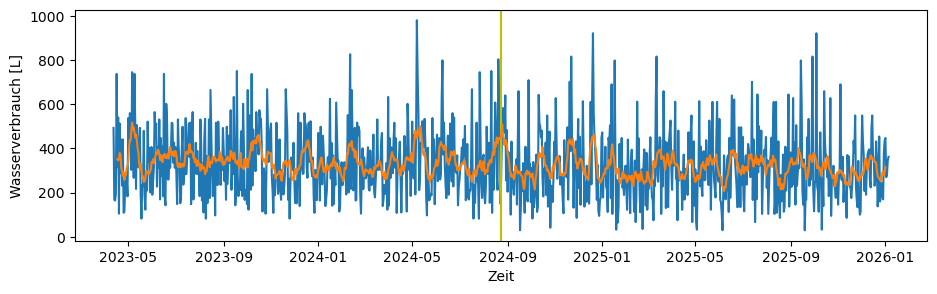

...

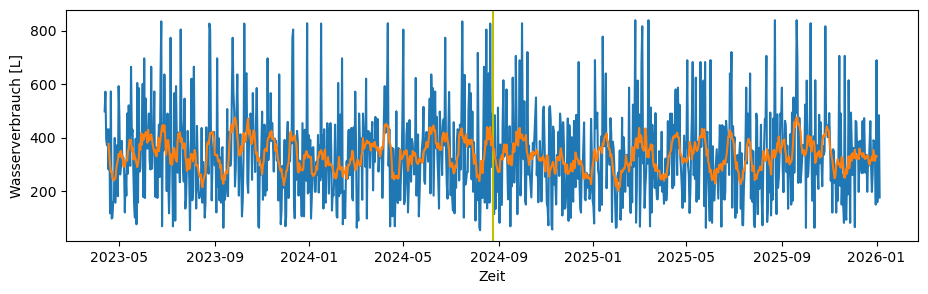

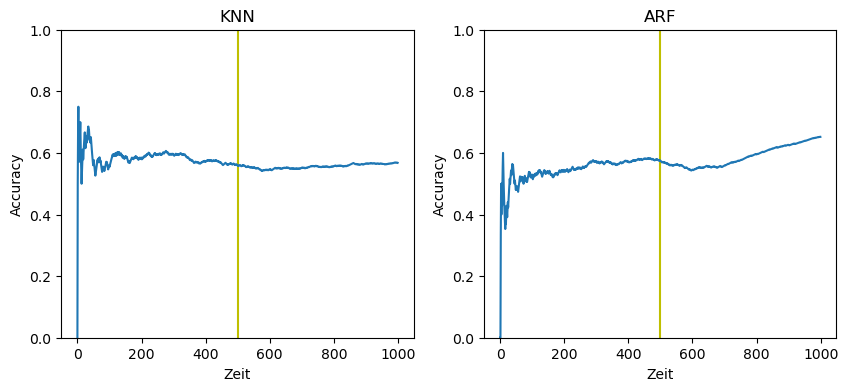

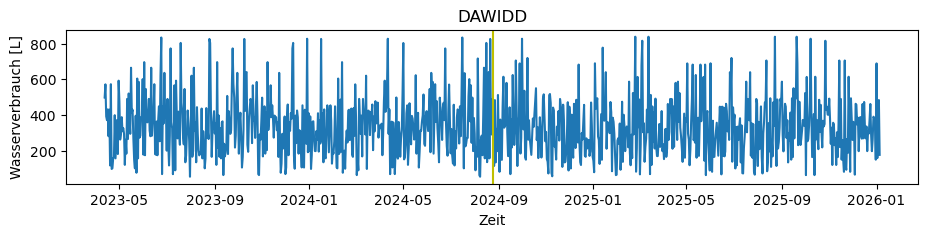

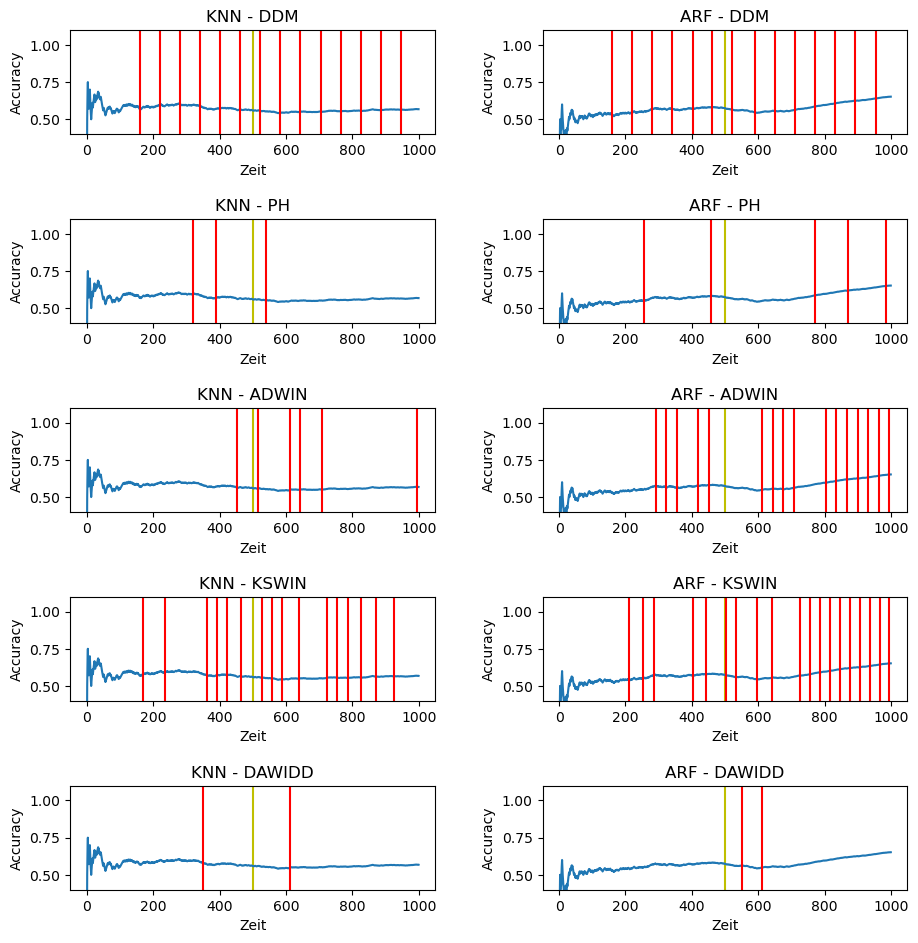

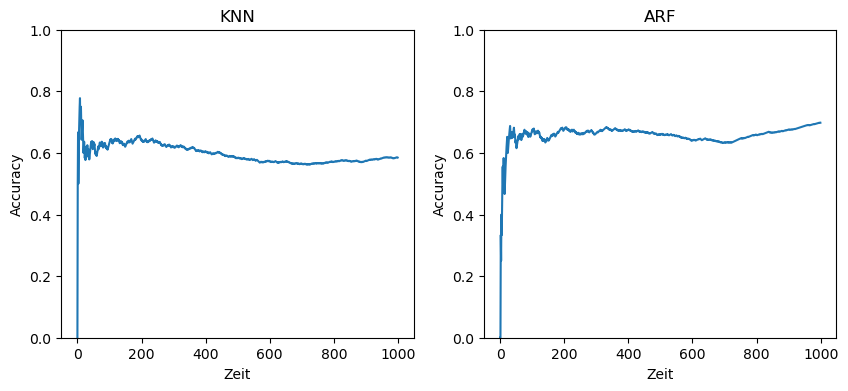

In [655]:
compute_online(dataset_5_enduse, 'Datensatz 5', days = days_5, print_plots = True, sum_ = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 10.2 	 	 1.0 	 	 	 0.0 	 	 [47 47 79 79 79]
ARF 	 	 DAWIDD	: 	 0.0 	 	 0.2 	 	 	 0.8 	 	 [18]
ARF 	 	 DDM	: 	 10.2 	 	 1.0 	 	 	 0.0 	 	 [59 37 28  5  5]
ARF 	 	 KSWIN	: 	 20.2 	 	 1.0 	 	 	 0.0 	 	 [22 27 30  0 29]
ARF 	 	 PH	: 	 2.6 	 	 1.0 	 	 	 0.0 	 	 [51 52 70 64 67]
DAWIDD 	 	 DAWIDD	: 	 0.2 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 ADWIN	: 	 6.6 	 	 0.6 	 	 	 0.4 	 	 [47 15 47]
KNN 	 	 DAWIDD	: 	 0.4 	 	 0.6 	 	 	 0.4 	 	 [72 71 71]
KNN 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [28 22 23 23 22]
KNN 	 	 KSWIN	: 	 11.2 	 	 1.0 	 	 	 0.0 	 	 [25 10 57  1  1]
KNN 	 	 PH	: 	 2.4 	 	 0.4 	 	 	 0.6 	 	 [50 10]
KNN Accuracy - 0.58
ARF Accuracy - 0.91
0.58 & 0.91
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 10.2 & 0.0 & 10.2 & 20.2 & 2.6 & 6.6 & 0.4 & 12.0 & 11.2 & 2.4 & 0.2
& Erkannt & 1.0 & 0.2 &

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


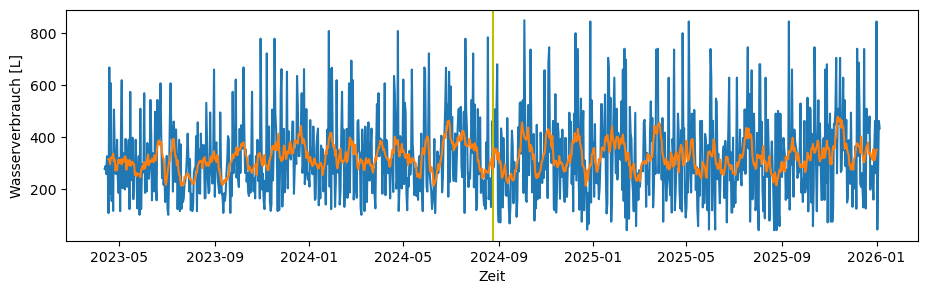

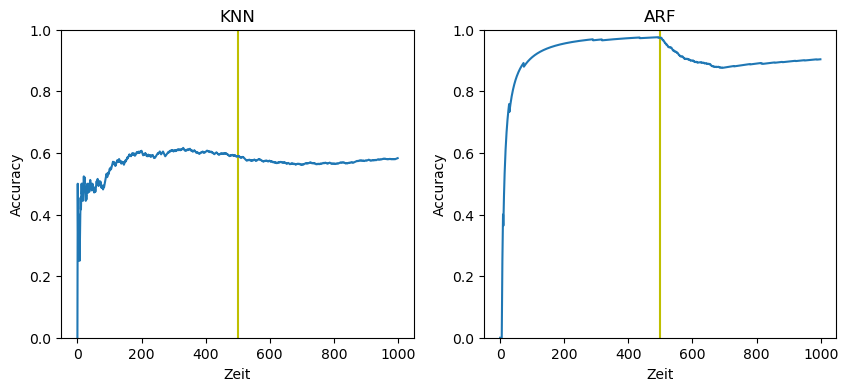

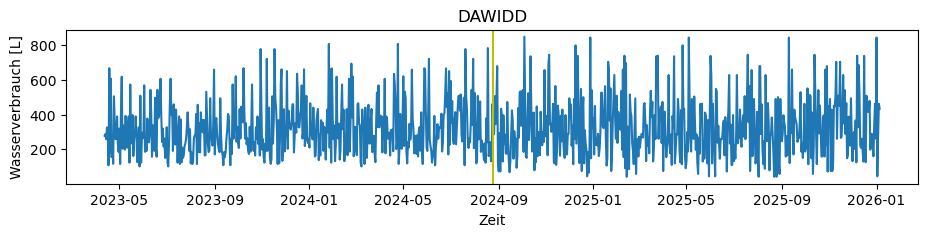

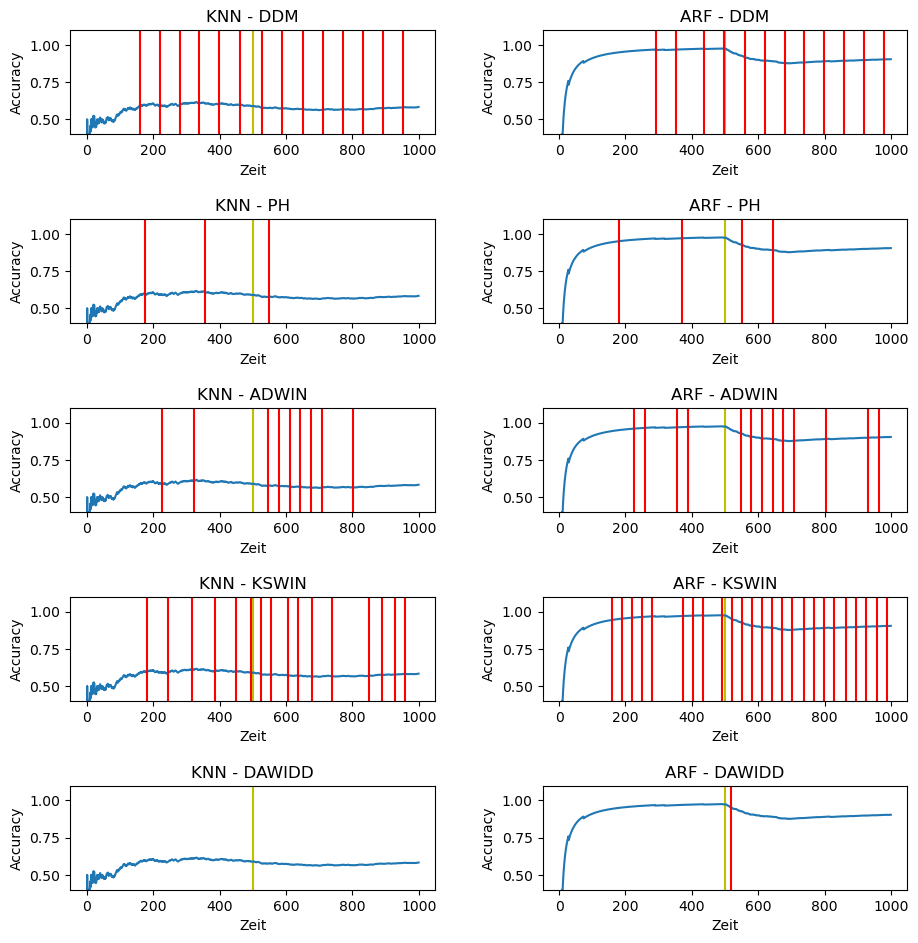

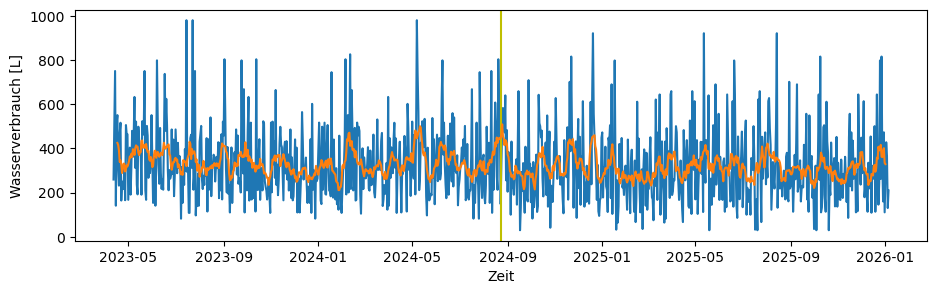

...

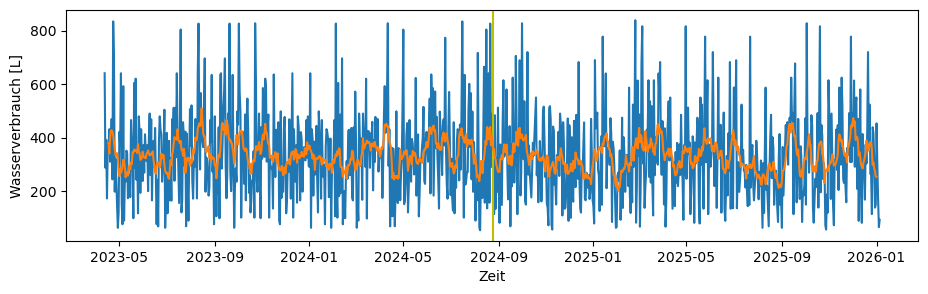

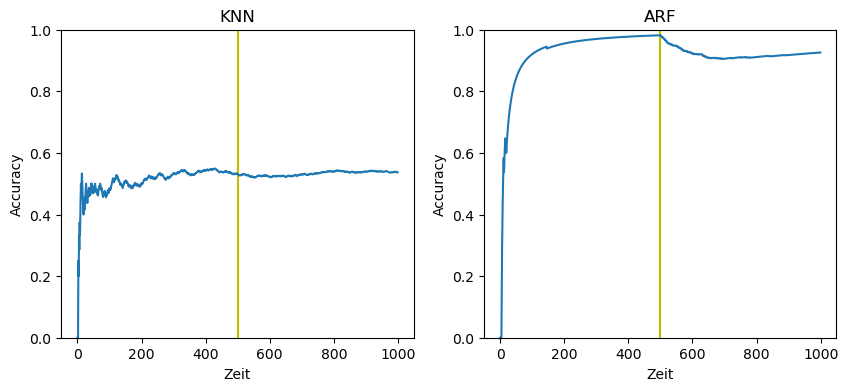

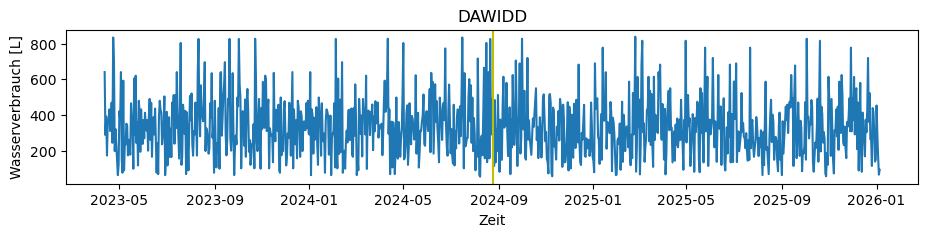

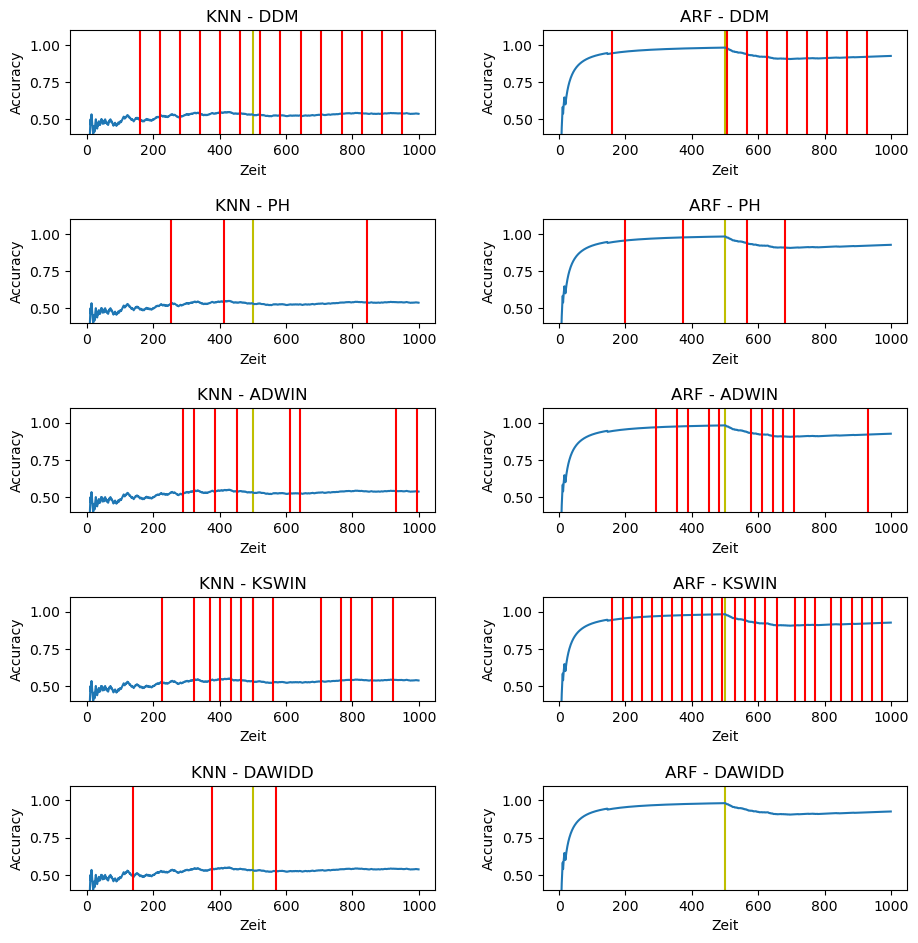

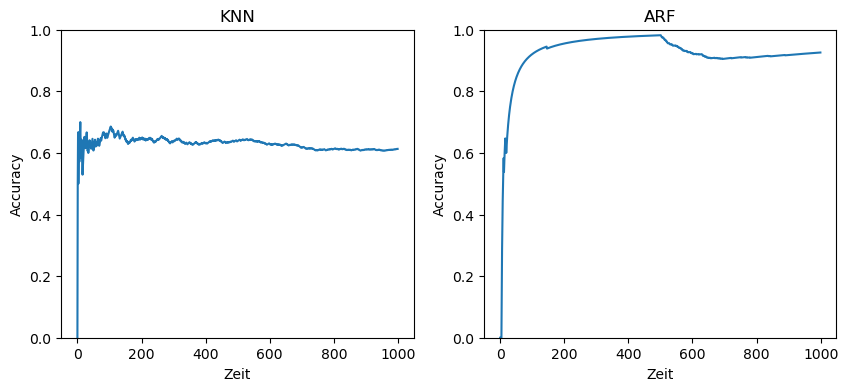

In [656]:
compute_online(dataset_5_enduse, 'Datensatz 5_enduse', days = days_5, print_plots = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 12.2 	 	 0.4 	 	 	 0.6 	 	 [47 47]
ARF 	 	 DAWIDD	: 	 1.8 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [21 24 24 21 19]
ARF 	 	 KSWIN	: 	 17.2 	 	 1.0 	 	 	 0.0 	 	 [ 6 45 18 50 13]
ARF 	 	 PH	: 	 3.8 	 	 0.8 	 	 	 0.2 	 	 [66 51 90  4]
DAWIDD 	 	 DAWIDD	: 	 2.8 	 	 1.0 	 	 	 0.0 	 	 [16 27 22 20  0]
KNN 	 	 ADWIN	: 	 9.0 	 	 0.4 	 	 	 0.6 	 	 [15 15]
KNN 	 	 DAWIDD	: 	 2.4 	 	 0.0 	 	 	 1.0 	 	 []
KNN 	 	 DDM	: 	 12.2 	 	 1.0 	 	 	 0.0 	 	 [21 22 23 27 25]
KNN 	 	 KSWIN	: 	 14.6 	 	 1.0 	 	 	 0.0 	 	 [ 0 32 19 16 26]
KNN 	 	 PH	: 	 3.6 	 	 0.4 	 	 	 0.6 	 	 [81 78]
KNN Accuracy - 0.62
ARF Accuracy - 0.66
0.62 & 0.66
ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 12.2 & 1.8 & 12.0 & 17.2 & 3.8 & 9.0 & 2.4 & 12.2 & 14.6 & 3.6 & 2.8
& Erkannt & 0.4 & 0.0 & 1.0 & 1.0 

C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


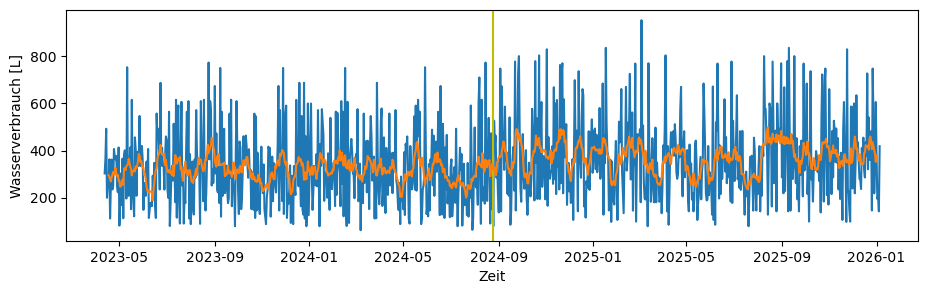

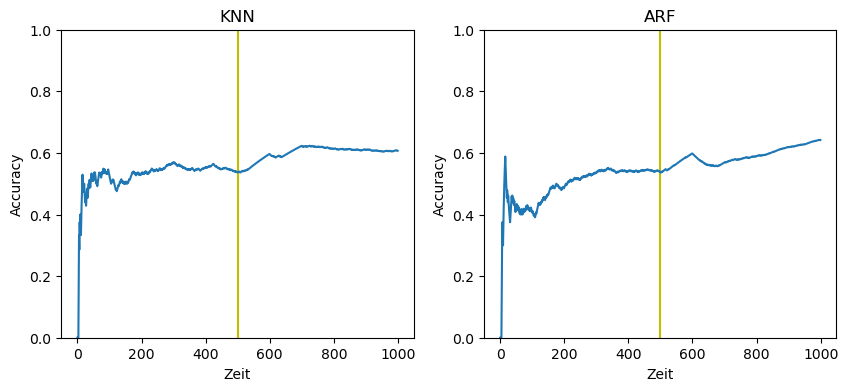

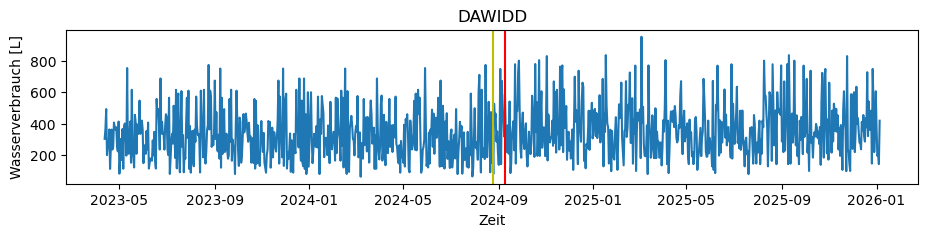

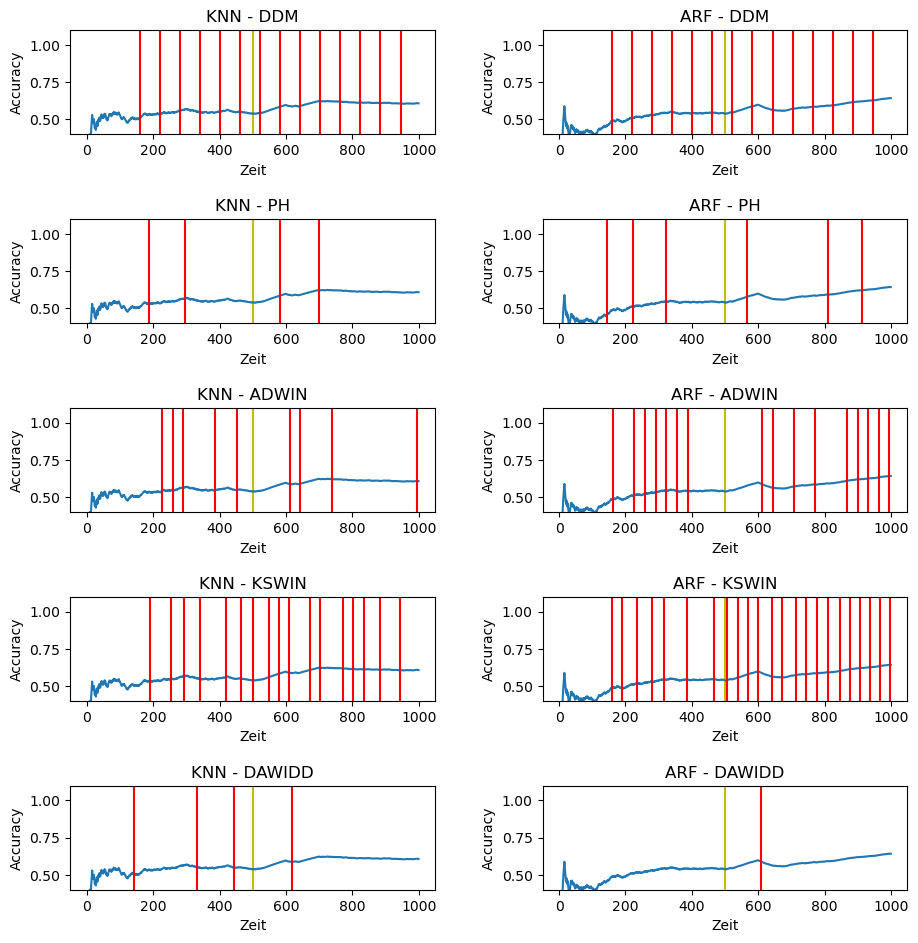

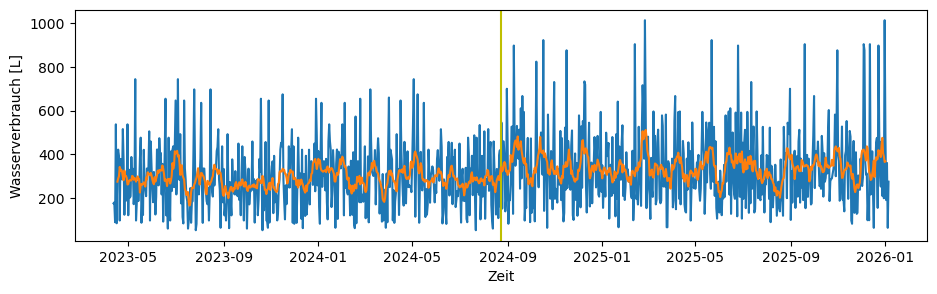

...

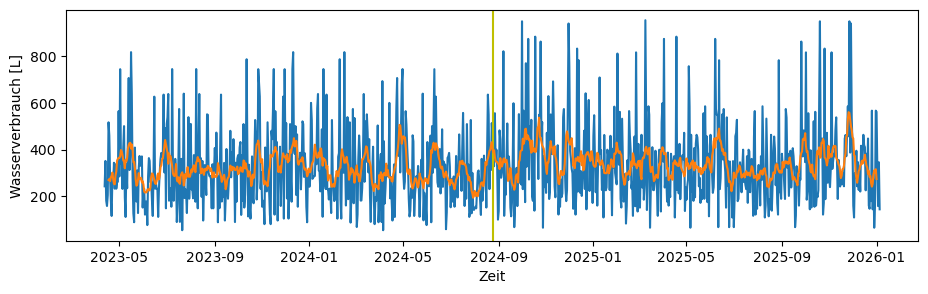

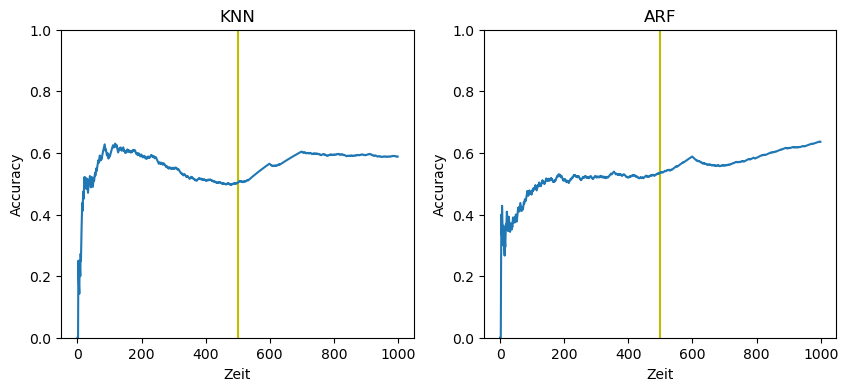

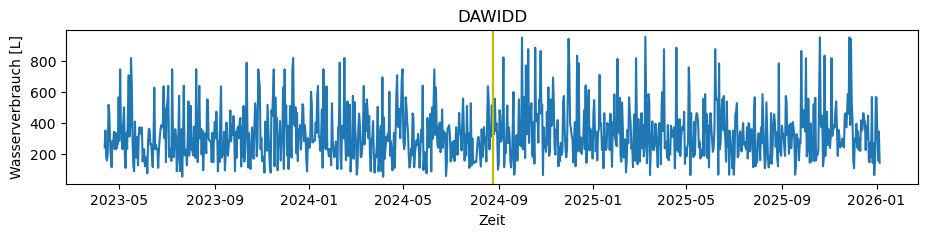

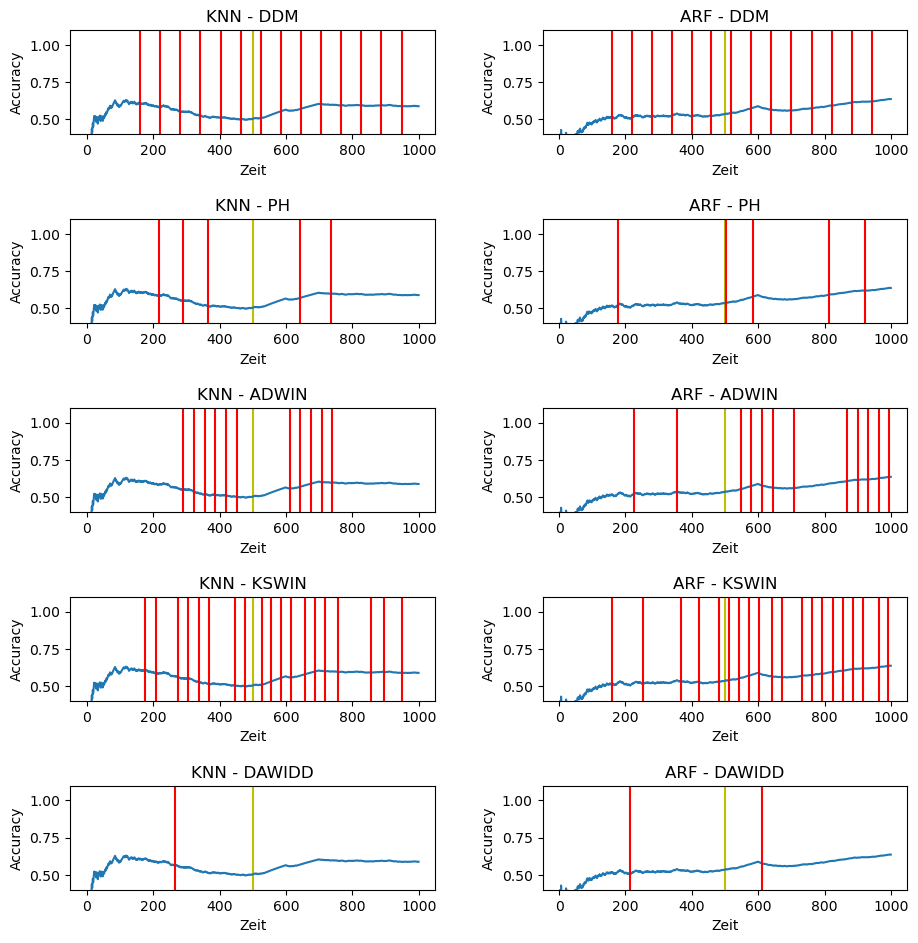

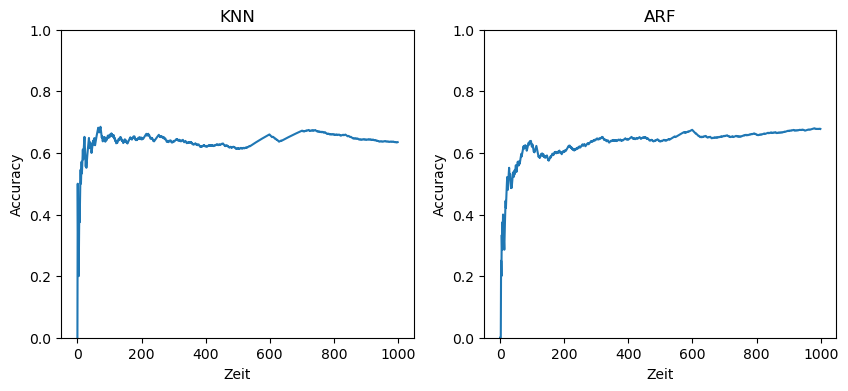

In [658]:
compute_online(dataset_6_enduse, 'Datensatz 6', days = days_6, print_plots = True, sum_ = True)

Classifier 	 Detection 	 False Alarm 	 Drift detected 	 Drift not 	 Delay
ARF 	 	 ADWIN	: 	 12.0 	 	 1.0 	 	 	 0.0 	 	 [47 15 79 47 47]
ARF 	 	 DAWIDD	: 	 1.6 	 	 0.0 	 	 	 1.0 	 	 []
ARF 	 	 DDM	: 	 12.6 	 	 1.0 	 	 	 0.0 	 	 [23 20 22 25 24]
ARF 	 	 KSWIN	: 	 17.4 	 	 1.0 	 	 	 0.0 	 	 [34 41 11  5 12]
ARF 	 	 PH	: 	 4.0 	 	 1.0 	 	 	 0.0 	 	 [19 69 55 41 26]
DAWIDD 	 	 DAWIDD	: 	 3.4 	 	 1.0 	 	 	 0.0 	 	 [31 28 34 29 28]
KNN 	 	 ADWIN	: 	 8.6 	 	 0.8 	 	 	 0.2 	 	 [15 15 15 79]
KNN 	 	 DAWIDD	: 	 1.8 	 	 0.4 	 	 	 0.6 	 	 [40 33]
KNN 	 	 DDM	: 	 12.4 	 	 1.0 	 	 	 0.0 	 	 [23 22 22 23 24]
KNN 	 	 KSWIN	: 	 13.2 	 	 1.0 	 	 	 0.0 	 	 [36 23 49 16  4]
KNN 	 	 PH	: 	 2.8 	 	 0.8 	 	 	 0.2 	 	 [80 97 98 69]
KNN Accuracy - 0.64
ARF Accuracy - 0.68
0.64 & 0.68


C:\Users\Vanessa\AppData\Local\Temp\ipykernel_23428\4118051024.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 2, figsize=(10,4))


ARF & ARF & ARF & ARF & ARF & KNN & KNN & KNN & KNN & KNN & DAWIDD
ADWIN & DAWIDD & DDM & KSWIN & PH & ADWIN & DAWIDD & DDM & KSWIN & PH & DAWIDD
& FA$^1$ & 12.0 & 1.6 & 12.6 & 17.4 & 4.0 & 8.6 & 1.8 & 12.4 & 13.2 & 2.8 & 3.4
& Erkannt & 1.0 & 0.0 & 1.0 & 1.0 & 1.0 & 0.8 & 0.4 & 1.0 & 1.0 & 0.8 & 1.0
& Nicht & 0.0 & 1.0 & 0.0 & 0.0 & 0.0 & 0.2 & 0.6 & 0.0 & 0.0 & 0.2 & 0.0
& Delay & [47, 15, 79, 47, 47] & [] & [23, 20, 22, 25, 24] & [34, 41, 11, 5, 12] & [19, 69, 55, 41, 26] & [15, 15, 15, 79] & [40, 33] & [23, 22, 22, 23, 24] & [36, 23, 49, 16, 4] & [80, 97, 98, 69] & [31, 28, 34, 29, 28]


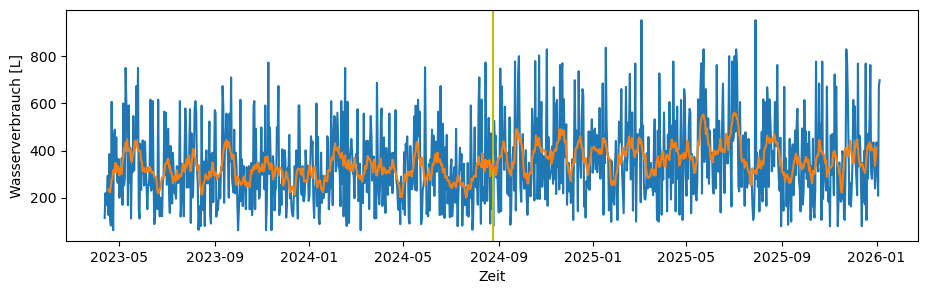

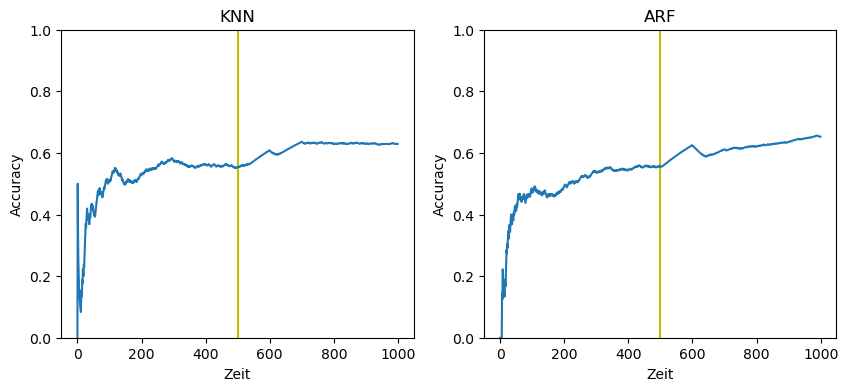

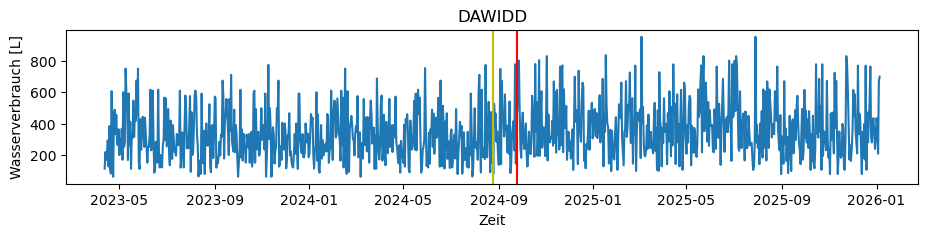

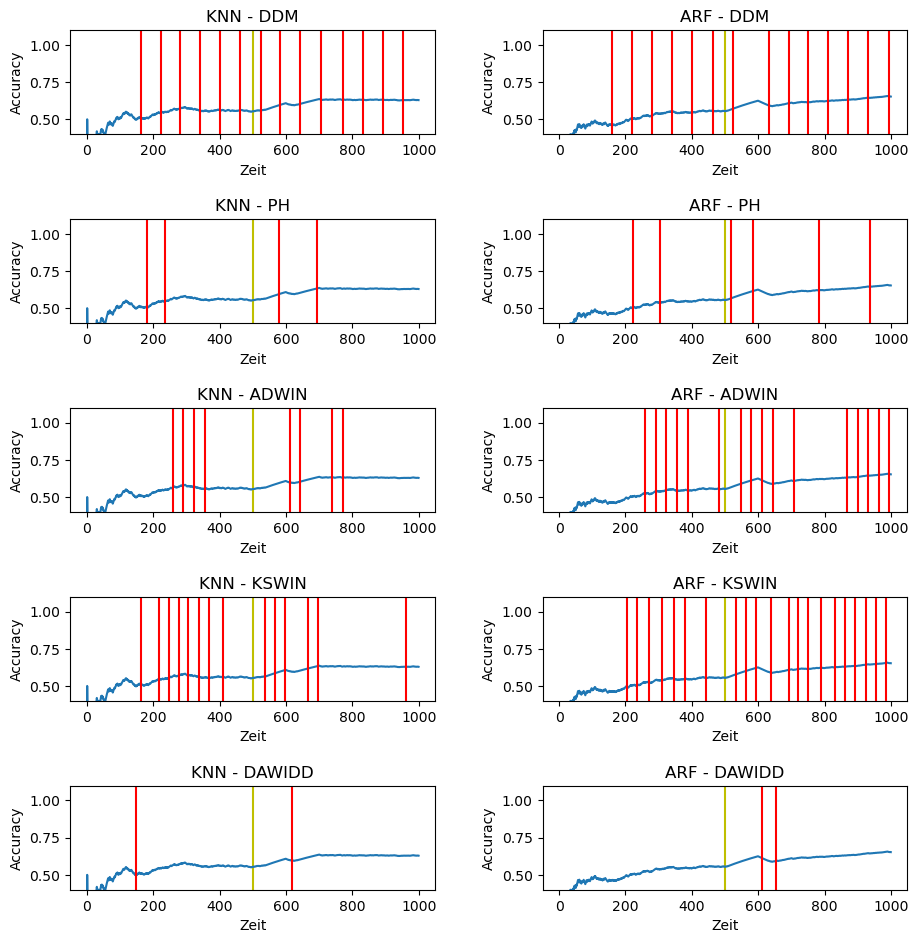

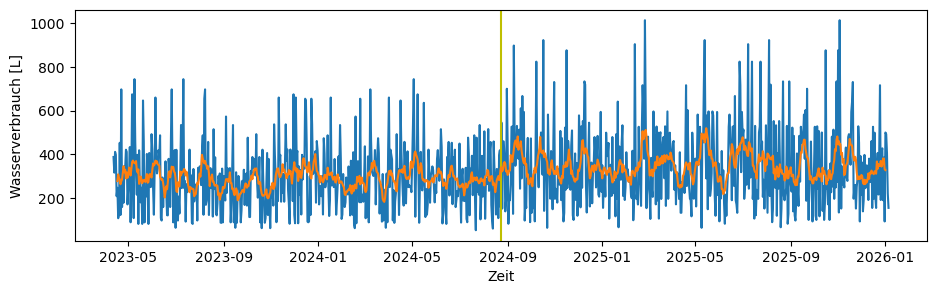

...

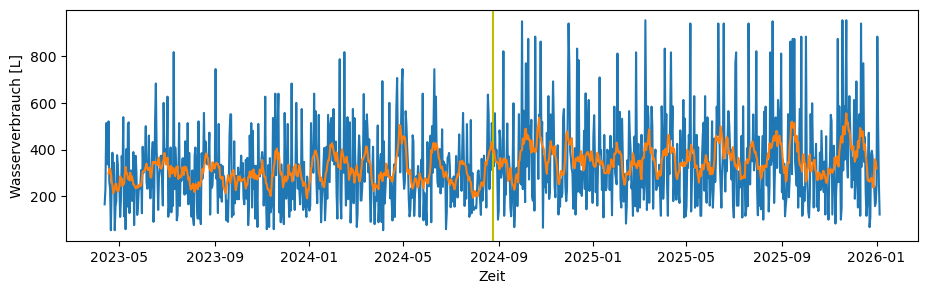

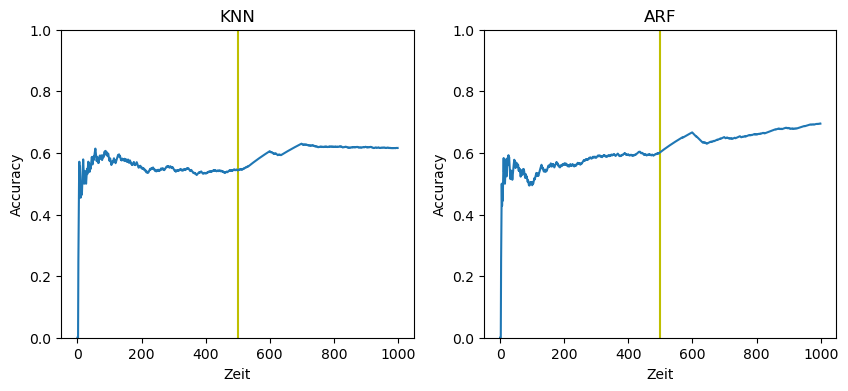

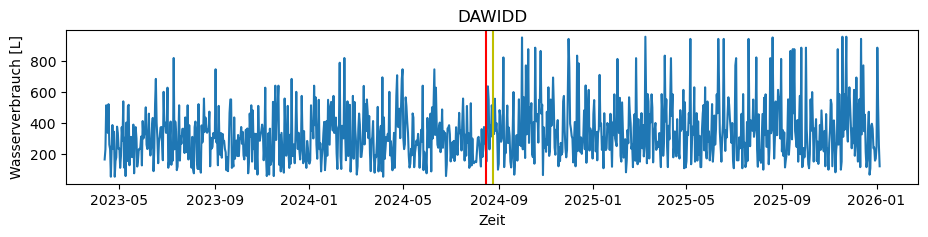

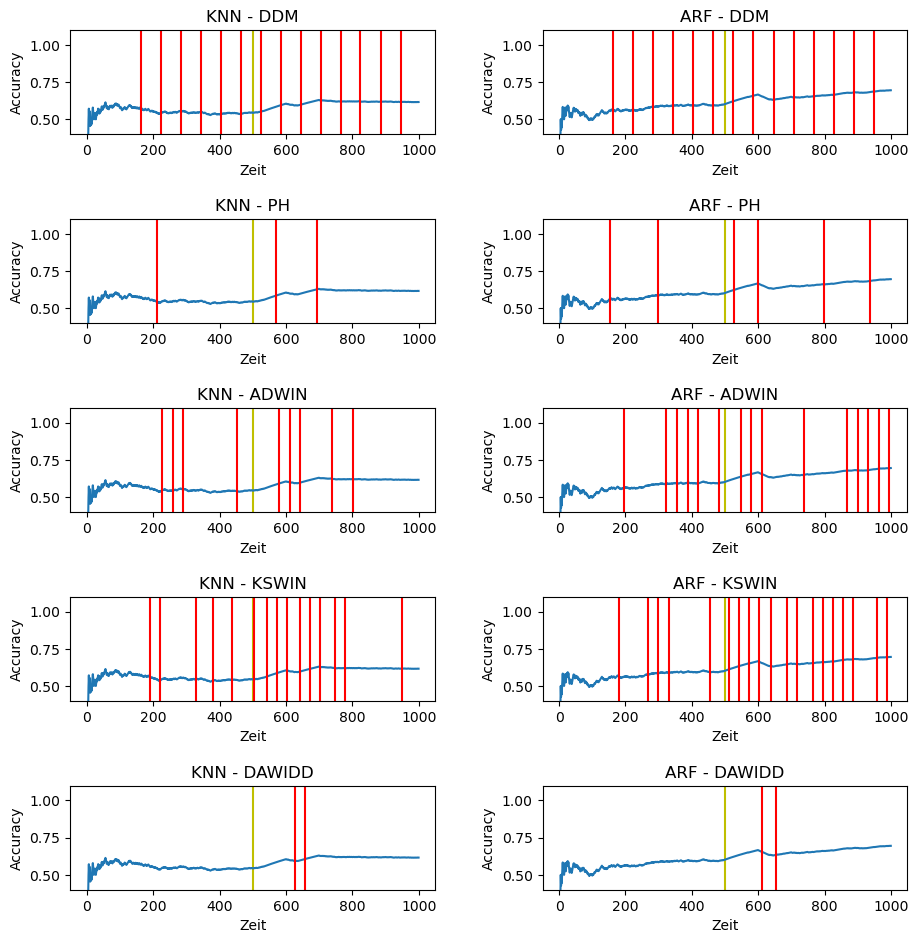

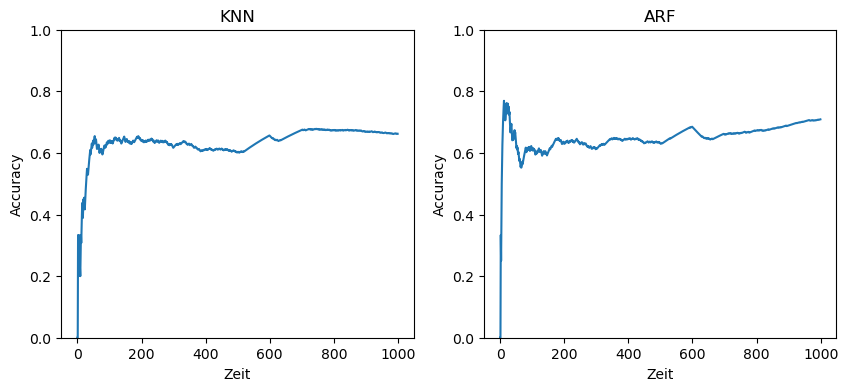

In [659]:
compute_online(dataset_6_enduse, 'Datensatz 6_enduse', days = days_6, print_plots = True)

## Weiteres

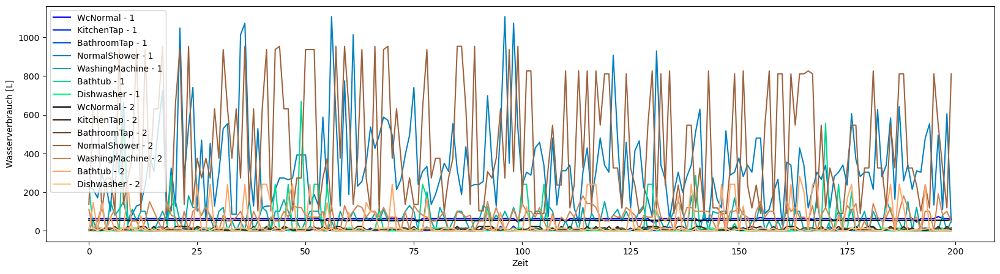

In [716]:
# Ausgabe des Einfluss von einzelnen Endgeräten

furnish = ['WcNormal', 'KitchenTap', 'BathroomTap', 'NormalShower', 'WashingMachine', 'Bathtub', 'Dishwasher']
color_1 = plt.cm.winter(np.linspace(0,1,len(furnish)))
color_2 = plt.cm.copper(np.linspace(0,1,len(furnish)))

for dataset_X, dataset_y in dataset_4_enduse:
    plt.figure(figsize=(20,5))

    for i in range(dataset_X.shape[1]):
        plt.plot(dataset_X[dataset_y == 1,i,0], label = furnish[i] + " - 1", color = color_1[i])
        
    for i in range(dataset_X.shape[1]):
        plt.plot(dataset_X[dataset_y == 2,i,0], label = furnish[i] + " - 2", color = color_2[i])
    
    plt.legend(loc = "upper left")
    plt.ylabel("Wasserverbrauch [L]")
    plt.xlabel("Zeit")
    
    break 


### Vergleich Kumulative Summe

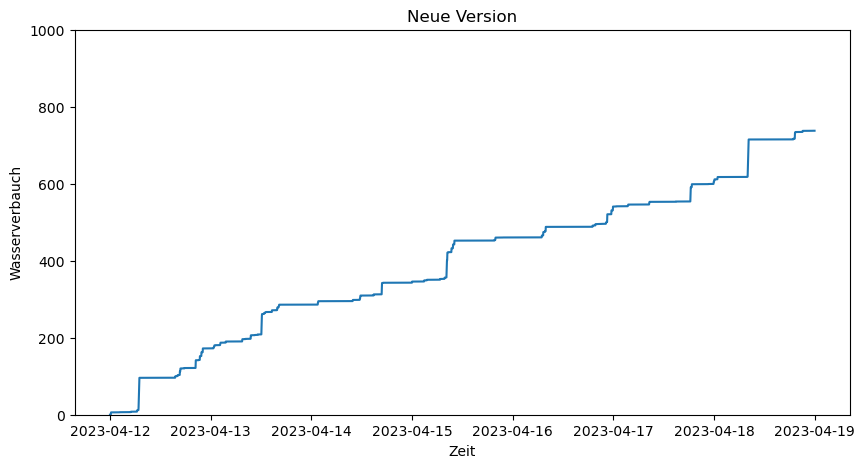

In [243]:
house_vgl = pysimdeum.built_house(house_type = 'one_person')
consumptions = house_vgl.simulate(duration = '7 day')
plt.figure(figsize=(10,5))
plt.ylabel('Wasserverbauch')
plt.xlabel('Zeit')
plt.title('Neue Version')
plt.ylim([0,1000])
x = pd.date_range(start= date_start, end= date_start + pd.to_timedelta('7 day'), freq='1s')
plt.plot(x, np.cumsum(consumptions.sum(['user', 'enduse', 'patterns'])))
#plt.savefig("C:\\Users\\Vanessa\\Downloads\\cumsum_new.png")